In [2]:
#GENERAL
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
import random

#PATH PROCESS
import os
import os.path
from pathlib import Path
import glob

#IMAGE PROCESS
from PIL import Image
from keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2
from keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.preprocessing import image
from skimage.feature import hessian_matrix, hessian_matrix_eigvals
from scipy.ndimage.filters import convolve
from skimage import data, io, filters
import skimage
from skimage.morphology import convex_hull_image, erosion

#SCALER & TRANSFORMATION
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from keras import regularizers
from sklearn.preprocessing import LabelEncoder

#ACCURACY CONTROL
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, roc_auc_score, roc_curve
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.metrics import mean_squared_error, r2_score

#OPTIMIZER
from keras.optimizers import RMSprop,Adam,Optimizer,Optimizer, SGD

#MODEL LAYERS
from tensorflow.keras.models import Sequential
from keras.layers import Dense,Input, Conv2D, Conv2DTranspose, UpSampling2D, Dropout, Flatten, Conv2D, MaxPool2D, MaxPooling2D, BatchNormalization,\
                        Permute, TimeDistributed, Bidirectional,GRU, SimpleRNN, LSTM, GlobalAveragePooling2D, SeparableConv2D,\
ZeroPadding2D, Convolution2D, ZeroPadding2D, Conv2DTranspose,ReLU, UpSampling2D, Concatenate, Conv2DTranspose
from keras import models
from tensorflow.keras.models import Model
from keras import layers
import tensorflow as tf
from keras.applications import VGG16,VGG19,inception_v3
from keras import backend as K
from keras.utils import plot_model
from keras.models import load_model
from keras import backend

#SKLEARN CLASSIFIER
from xgboost import XGBClassifier, XGBRegressor
from lightgbm import LGBMClassifier, LGBMRegressor
from catboost import CatBoostClassifier, CatBoostRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import BaggingRegressor
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.neural_network import MLPClassifier, MLPRegressor
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.linear_model import LinearRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import Lasso
from sklearn.linear_model import LassoCV
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import ElasticNetCV

#IGNORING WARNINGS
from warnings import filterwarnings
filterwarnings("ignore",category=DeprecationWarning)
filterwarnings("ignore", category=FutureWarning)
filterwarnings("ignore", category=UserWarning)

<ipython-input-2-1979b22ebfab>:23: DeprecationWarning: Please use `convolve` from the `scipy.ndimage` namespace, the `scipy.ndimage.filters` namespace is deprecated.
  from scipy.ndimage.filters import convolve


In [3]:
from google.colab import files

# Upload the Kaggle API key JSON file that you obtained from your Kaggle account
uploaded = files.upload()

# Move the uploaded file to the appropriate directory
!mkdir -p ~/.kaggle
!mv kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

Saving kaggle.json to kaggle.json


In [ ]:
!pip install kaggle

In [1]:
!pip install catboost

In [4]:
# Downloading the dataset using the Kaggle API
!kaggle datasets download -d ashish2001/semantic-segmentation-of-underwater-imagery-suim

100% 175M/176M [00:06<00:00, 34.8MB/s]
100% 176M/176M [00:06<00:00, 29.8MB/s]


In [ ]:
# Unzip the downloaded dataset
!unzip semantic-segmentation-of-underwater-imagery-suim.zip

In [6]:
MAIN_IMAGE_PATH = Path("/content/train_val/images")
MAIN_MASK_PATH = Path("/content/train_val/masks")

In [7]:
OBJECT_PATH = list(MAIN_IMAGE_PATH.glob(r"*.jpg"))
MASK_PATH = list(MAIN_MASK_PATH.glob(r"*.bmp"))

In [8]:
print("OBJECT_PATH: ", len(OBJECT_PATH))
print("MASK_PATH: ", len(MASK_PATH))

OBJECT_PATH:  1525
MASK_PATH:  1525


In [9]:
MAIN_TEST_IMAGE_PATH = Path("/content/TEST/images")
MAIN_TEST_MASK_PATH = Path("/content/TEST/masks")
TEST_OBJECT_PATH = list(MAIN_TEST_IMAGE_PATH.glob(r"*.jpg"))
TEST_MASK_PATH = list(MAIN_TEST_MASK_PATH.glob(r"*.bmp"))

In [10]:
print("TEST_OBJECT_PATH: ", len(TEST_OBJECT_PATH))
print("TEST_MASK_PATH: ", len(TEST_MASK_PATH))

TEST_OBJECT_PATH:  110
TEST_MASK_PATH:  110


In [11]:
OBJECT_PATH = sorted(OBJECT_PATH)
MASK_PATH = sorted(MASK_PATH)

In [12]:
# to series
OBJECT_SERIES = pd.Series(OBJECT_PATH,name="OBJECTS").astype(str)
MASK_SERIES = pd.Series(MASK_PATH,name="MASK").astype(str)

In [13]:
# to dataframe
MAIN_DATA = pd.concat([OBJECT_SERIES,MASK_SERIES],axis=1)
MAIN_DATA

,OBJECTS,MASK
0,/content/train_val/images/d_r_103_.jpg,/content/train_val/masks/d_r_103_.bmp
1,/content/train_val/images/d_r_105_.jpg,/content/train_val/masks/d_r_105_.bmp
2,/content/train_val/images/d_r_112_.jpg,/content/train_val/masks/d_r_112_.bmp
3,/content/train_val/images/d_r_113_.jpg,/content/train_val/masks/d_r_113_.bmp
4,/content/train_val/images/d_r_125_.jpg,/content/train_val/masks/d_r_125_.bmp
...,...,...
1520,/content/train_val/images/w_r_95_.jpg,/content/train_val/masks/w_r_95_.bmp
1521,/content/train_val/images/w_r_96_.jpg,/content/train_val/masks/w_r_96_.bmp
1522,/content/train_val/images/w_r_98_.jpg,/content/train_val/masks/w_r_98_.bmp
1523,/content/train_val/images/w_r_99_.jpg,/content/train_val/masks/w_r_99_.bmp


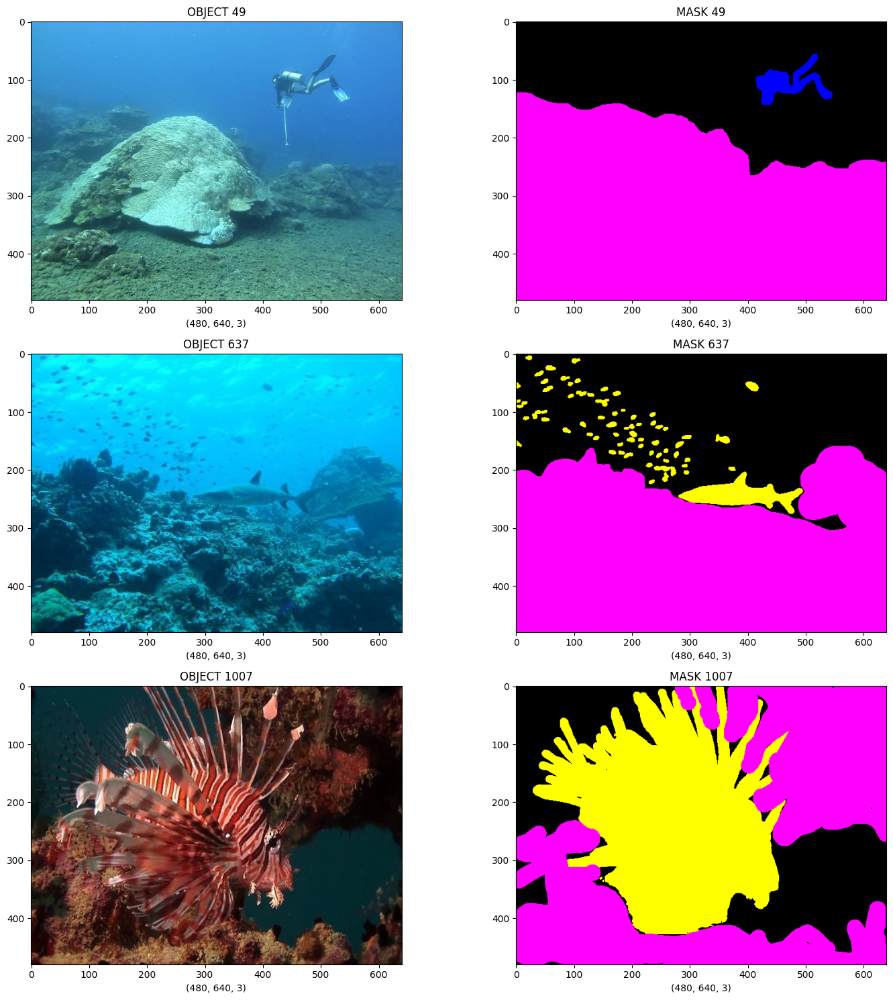

In [ ]:
# VISION
# General control

indices_to_display = [49, 637, 1007]
figure, axes = plt.subplots(len(indices_to_display), 2, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    axes[i, 1].set_xlabel(example_mask.shape)
    axes[i, 1].set_title(f"MASK {index}")
    axes[i, 1].imshow(example_mask)

plt.tight_layout()
plt.show()

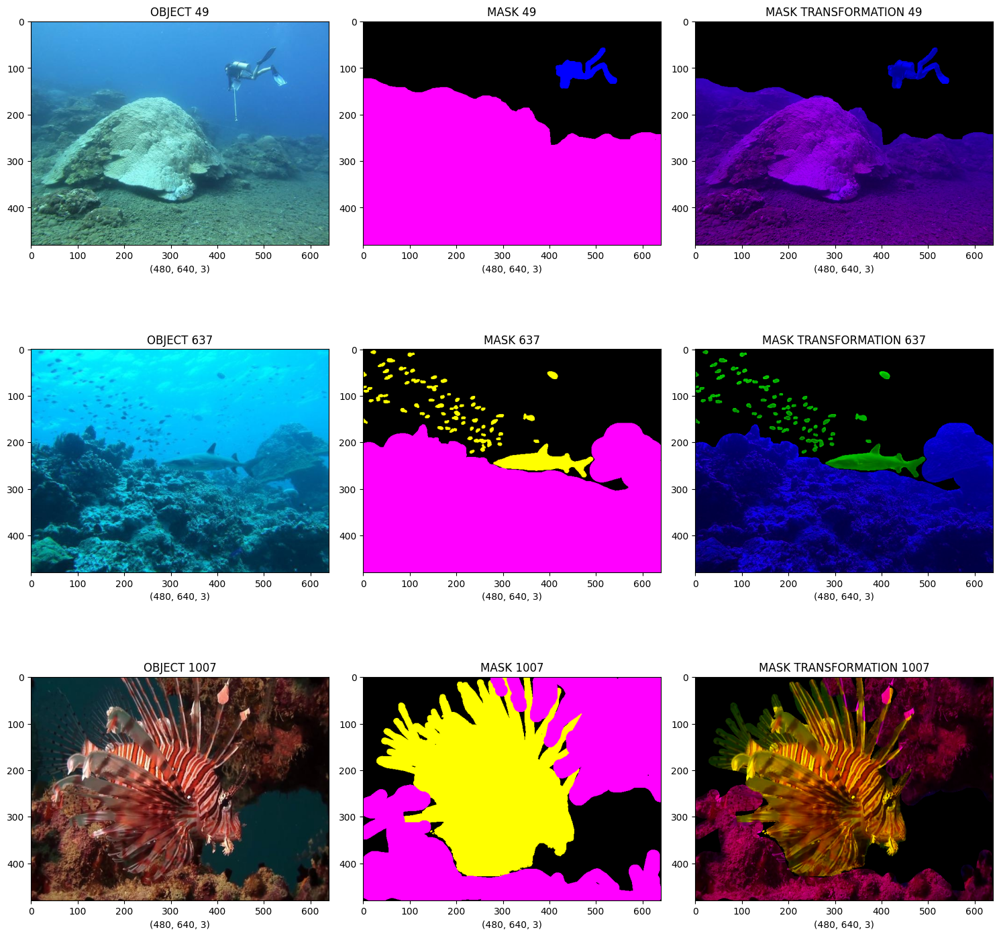

In [ ]:
# Transformation layer

indices_to_display = [ 49, 637, 1007]

figure, axes = plt.subplots(len(indices_to_display), 3, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    copy_object = example_object.copy()
    copy_object[example_mask == 0] = 0
    # contain the parts of the object that are present in the mask, and the rest will be set to 0. Here we want to isolate specific regions based on a mask.

    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    axes[i, 1].set_xlabel(example_mask.shape)
    axes[i, 1].set_title(f"MASK {index}")
    axes[i, 1].imshow(example_mask)

    axes[i, 2].set_xlabel(copy_object.shape)
    axes[i, 2].set_title(f"MASK TRANSFORMATION {index}")
    axes[i, 2].imshow(copy_object)

plt.tight_layout()
plt.show()


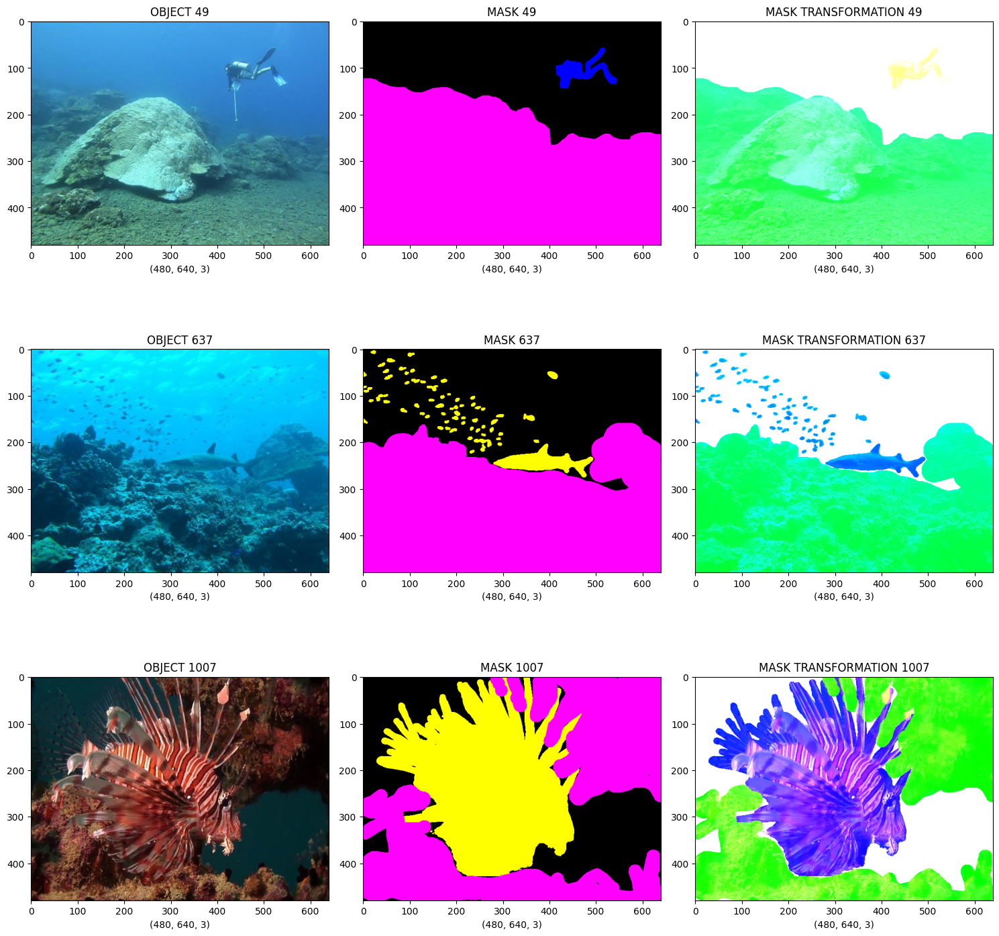

In [ ]:
indices_to_display = [49, 637, 1007]
figure, axes = plt.subplots(len(indices_to_display), 3, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    copy_object = example_object.copy()
    copy_object[example_mask == 0] = 255
    # have pixel values set to 255 in regions where the mask is 0, effectively highlighting the background or areas outside the object.

    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    axes[i, 1].set_xlabel(example_mask.shape)
    axes[i, 1].set_title(f"MASK {index}")
    axes[i, 1].imshow(example_mask)

    axes[i, 2].set_xlabel(copy_object.shape)
    axes[i, 2].set_title(f"MASK TRANSFORMATION {index}")
    axes[i, 2].imshow(copy_object)

plt.tight_layout()
plt.show()


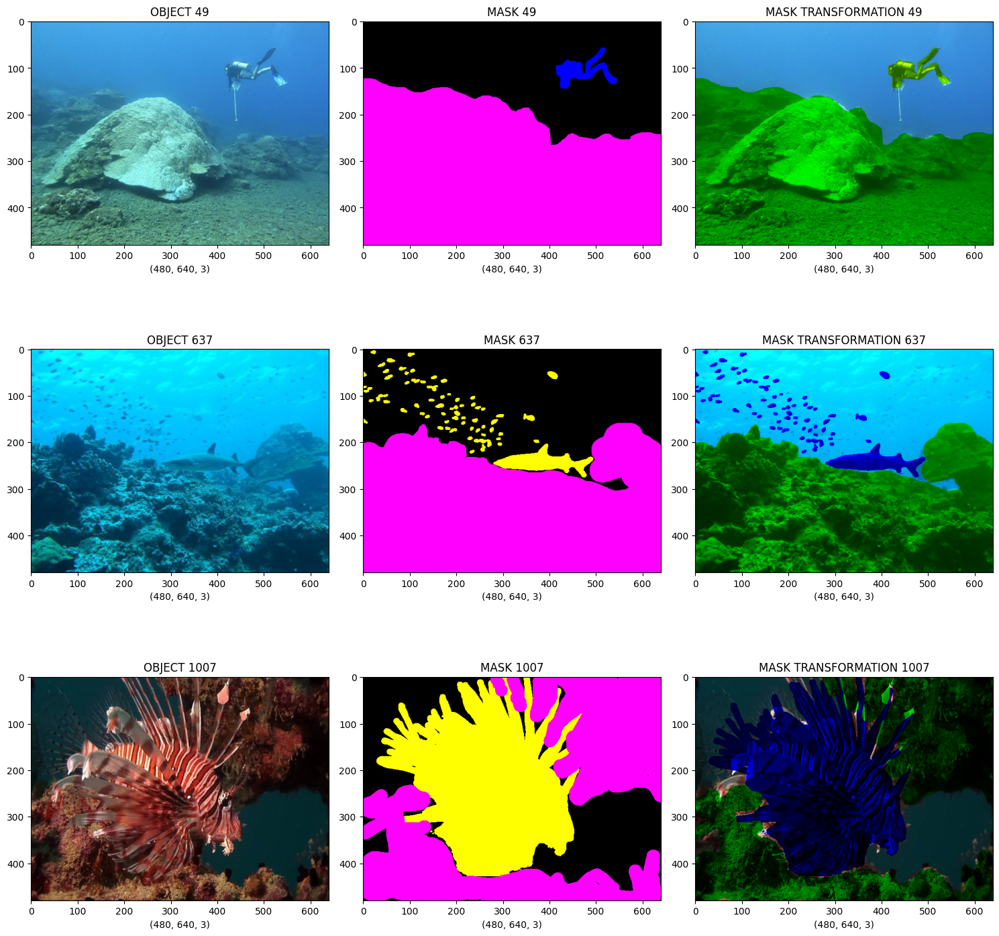

In [ ]:
indices_to_display = [49, 637, 1007]

figure, axes = plt.subplots(len(indices_to_display), 3, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    copy_object = example_object.copy()
    copy_object[example_mask == 255] = 0
    #  have pixel values set to 0 in regions where the mask is 255, effectively removing parts of the object that are covered by the mask.

    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    axes[i, 1].set_xlabel(example_mask.shape)
    axes[i, 1].set_title(f"MASK {index}")
    axes[i, 1].imshow(example_mask)

    axes[i, 2].set_xlabel(copy_object.shape)
    axes[i, 2].set_title(f"MASK TRANSFORMATION {index}")
    axes[i, 2].imshow(copy_object)

plt.tight_layout()
plt.show()


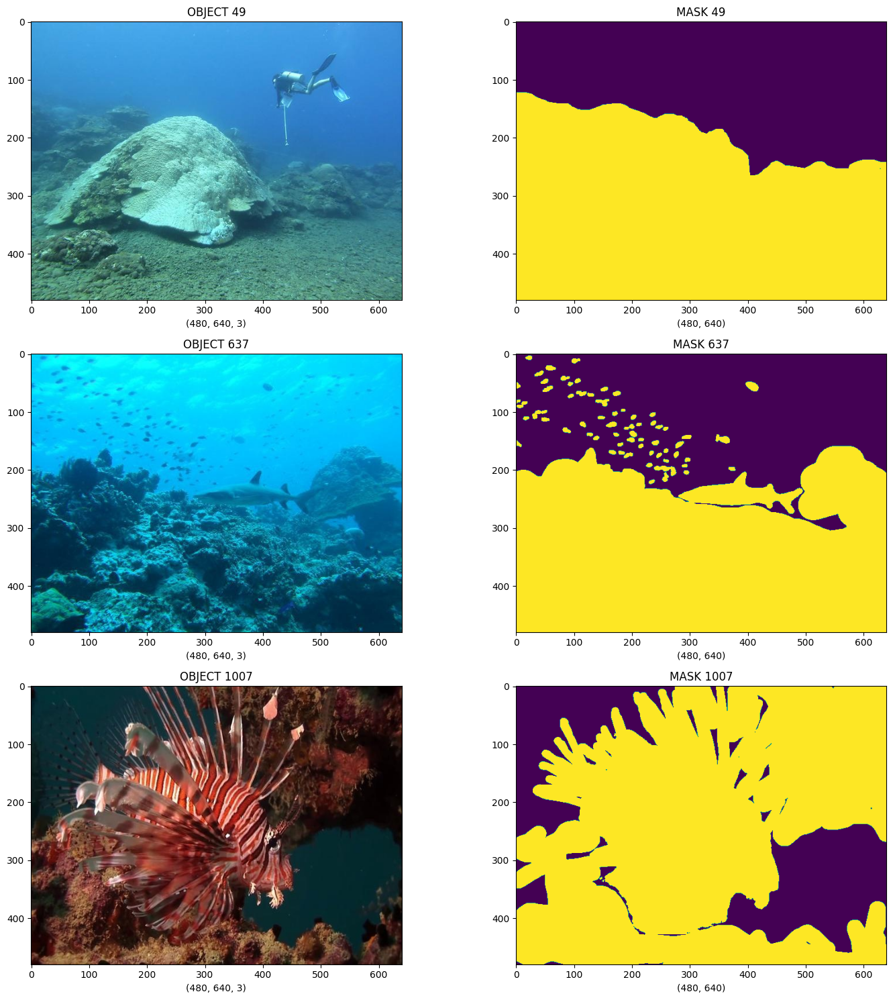

In [ ]:
indices_to_display = [49, 637, 1007]

figure, axes = plt.subplots(len(indices_to_display), 2, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    axes[i, 1].set_xlabel(example_mask[:, :, 0].shape)
    axes[i, 1].set_title(f"MASK {index}")
    axes[i, 1].imshow(example_mask[:, :, 0] == 255)
    # create a binary mask that highlights the regions in the red channel where the object is present
    # pixel values of 255 are used to represent the presence of an object or a region of interest, especially in binary masks.

plt.tight_layout()
plt.show()


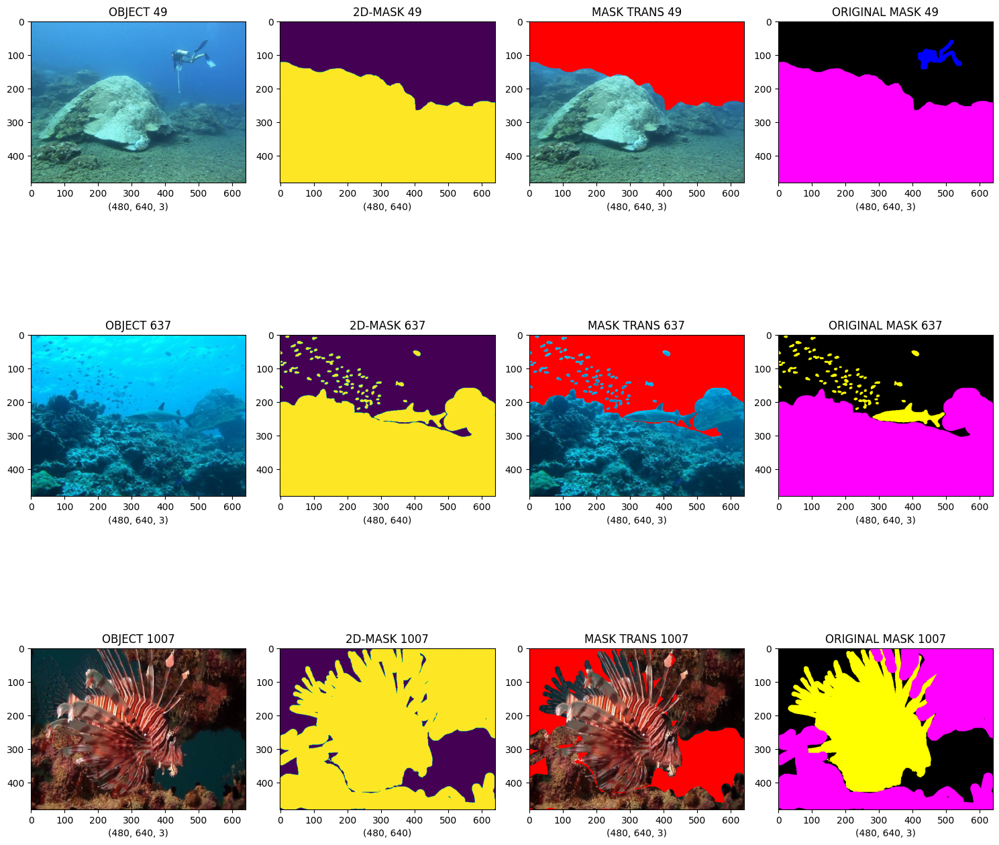

In [ ]:
indices_to_display = [49, 637, 1007]

figure, axes = plt.subplots(len(indices_to_display), 4, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    object_path_trans = example_mask[:, :, 0] == 0

    copy_object = example_object.copy()
    copy_object[object_path_trans] = [255, 0, 0]

    # original color image of the object without any modifications
    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    # highlights the regions where the red channel of the mask is equal to 255. It's a visualization of the mask, where white pixels represent the areas recognized as the object.
    axes[i, 1].set_xlabel(example_mask[:, :, 0].shape)
    axes[i, 1].set_title(f"2D-MASK {index}")
    axes[i, 1].imshow(example_mask[:, :, 0] == 255)

    # highlighting specific regions in red where the corresponding pixel in the binary mask is True. It helps visualize the impact of the mask on the object.
    axes[i, 2].set_xlabel(copy_object.shape)
    axes[i, 2].set_title(f"MASK TRANS {index}")
    axes[i, 2].imshow(copy_object)

    # original mask associated with the object
    axes[i, 3].set_xlabel(example_mask.shape)
    axes[i, 3].set_title(f"ORIGINAL MASK {index}")
    axes[i, 3].imshow(example_mask)

plt.tight_layout()
plt.show()


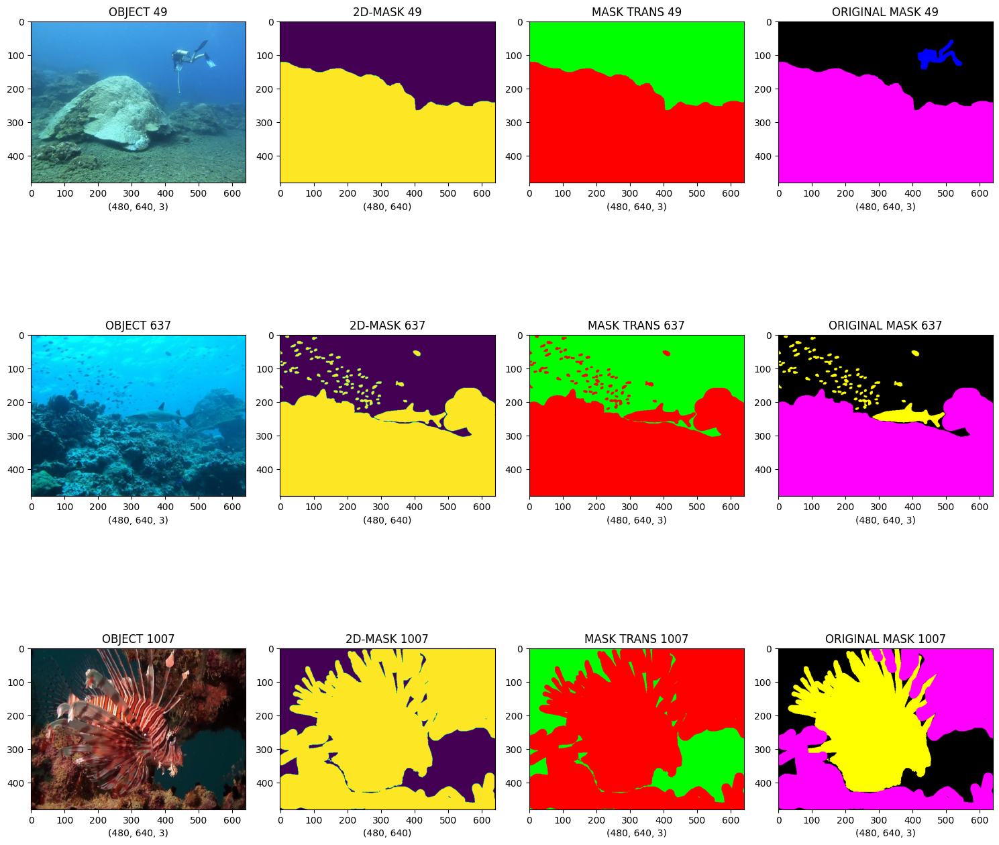

In [ ]:
indices_to_display = [49, 637, 1007]

figure, axes = plt.subplots(len(indices_to_display), 4, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    object_path_trans = example_mask[:, :, 0] == 0

    copy_object = example_object.copy()
    copy_object[object_path_trans == 0] = [255, 0, 0]
    copy_object[object_path_trans == 1] = [0, 255, 0]

    # original color image of the object without any modifications
    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    # Highlights the regions where the red channel of the mask is equal to 255
    axes[i, 1].set_xlabel(example_mask[:, :, 0].shape)
    axes[i, 1].set_title(f"2D-MASK {index}")
    axes[i, 1].imshow(example_mask[:, :, 0] == 255)

    # Regions where the binary mask is True (red channel is 0) are highlighted in red ([255, 0, 0]). Regions where the binary mask is False (red channel is not 0) are highlighted in green ([0, 255, 0]).
    # This visualization emphasizes the impact of the binary mask on the color representation of the object.
    axes[i, 2].set_xlabel(copy_object.shape)
    axes[i, 2].set_title(f"MASK TRANS {index}")
    axes[i, 2].imshow(copy_object)

    # original mask associated with the object
    axes[i, 3].set_xlabel(example_mask.shape)
    axes[i, 3].set_title(f"ORIGINAL MASK {index}")
    axes[i, 3].imshow(example_mask)

plt.tight_layout()
plt.show()


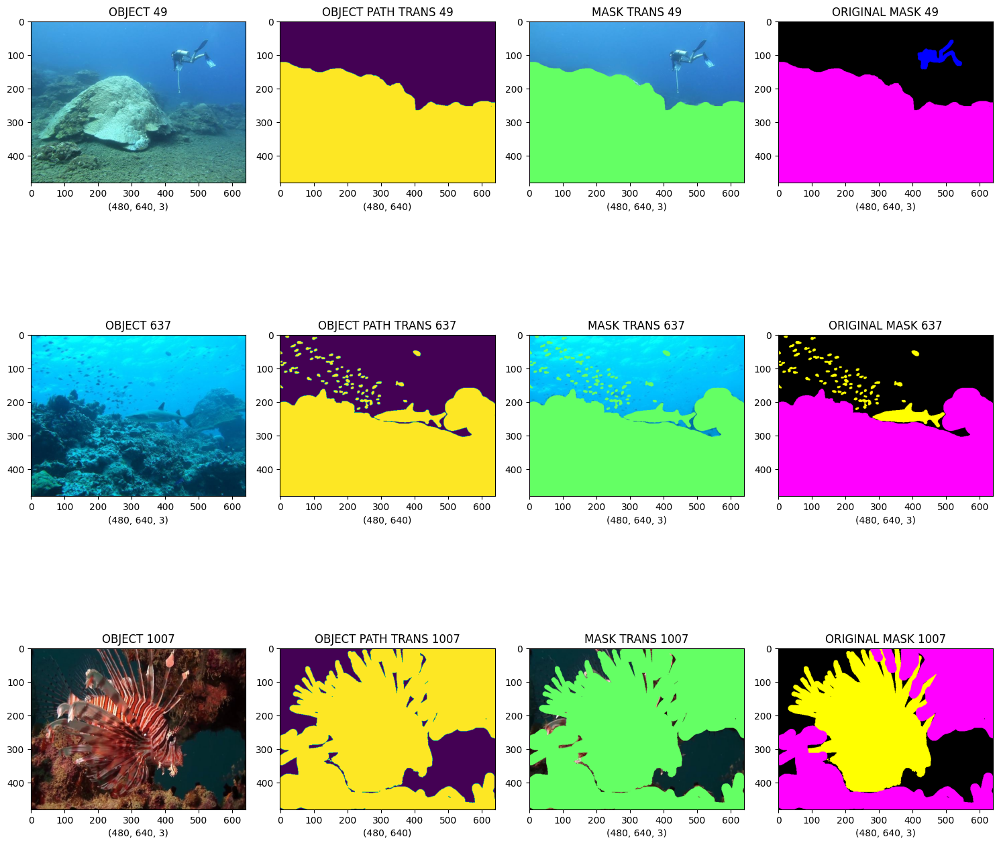

In [ ]:
indices_to_display = [49, 637, 1007]
figure, axes = plt.subplots(len(indices_to_display), 4, figsize=(15, 5 * len(indices_to_display)))

for i, index in enumerate(indices_to_display):
    example_object = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    example_mask = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    object_path_trans = example_mask[:, :, 0] == 255

    copy_object = example_object.copy()
    copy_object[object_path_trans] = [100, 255, 100]

    # original color image of the object without any modifications
    axes[i, 0].set_xlabel(example_object.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(example_object)

    # Highlights the regions where the red channel of the mask is equal to 255
    axes[i, 1].set_xlabel(object_path_trans.shape)
    axes[i, 1].set_title(f"OBJECT PATH TRANS {index}")
    axes[i, 1].imshow(object_path_trans)

    # Regions where the binary mask is True (red channel is 255) are highlighted in green ([100, 255, 100]). Regions where the binary mask is False (red channel is not 255) remain unchanged.
    axes[i, 2].set_xlabel(copy_object.shape)
    axes[i, 2].set_title(f"MASK TRANS {index}")
    axes[i, 2].imshow(copy_object)

    # original mask associated with the object
    axes[i, 3].set_xlabel(example_mask.shape)
    axes[i, 3].set_title(f"ORIGINAL MASK {index}")
    axes[i, 3].imshow(example_mask)

plt.tight_layout()
plt.show()


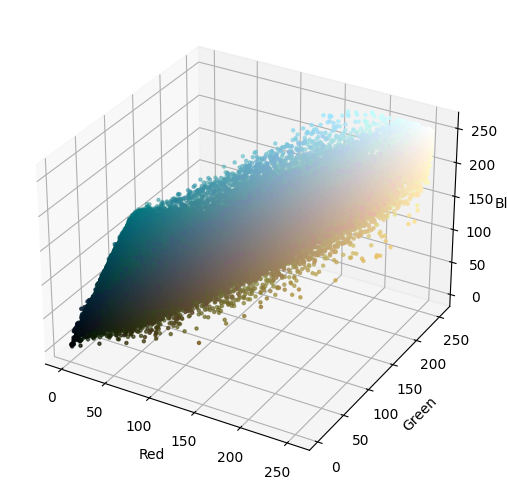

In [ ]:
# Color space
# 3D space

EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][640]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_OBJECT)

figure = plt.figure(figsize=(5,5))
axis_func = figure.add_subplot(1, 1, 1, projection="3d")

Pixel_Colors_I = EXAMPLE_OBJECT.reshape((np.shape(EXAMPLE_OBJECT)[0] * np.shape(EXAMPLE_OBJECT)[1], 3))
Normalize_I = colors.Normalize(vmin=-1.,vmax=1.)
Normalize_I.autoscale(Pixel_Colors_I)
Result_Pixel = Normalize_I(Pixel_Colors_I).tolist()

axis_func.scatter(Red_I.flatten(), Green_I.flatten(), Blue_I.flatten(), facecolors=Result_Pixel, marker=".")

axis_func.set_xlabel("Red")
axis_func.set_ylabel("Green")
axis_func.set_zlabel("Blue")

plt.tight_layout()
plt.show()

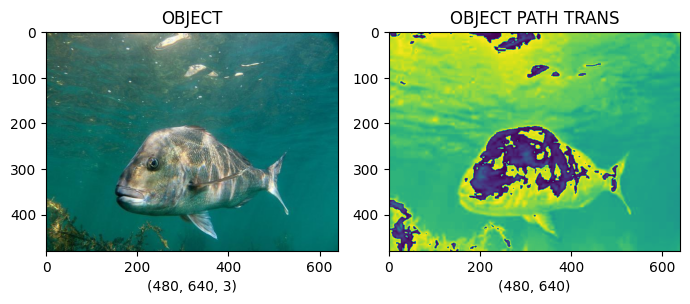

In [ ]:
# SUB LAYER

EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][640]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][640]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_OBJECT)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
OBJECT_PATH_TRANS = COPY_OBJECT[:,:,0] - Blue_I

figure,axis = plt.subplots(1,2,figsize=(7,7))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)


# highlight areas where the blue channel has been modified or transformed. This type of analysis can be useful for understanding the impact of specific color channels on the overall appearance of the object
axis[1].set_xlabel(OBJECT_PATH_TRANS.shape)
axis[1].set_title("OBJECT PATH TRANS")
axis[1].imshow(OBJECT_PATH_TRANS)


plt.tight_layout()
plt.show()

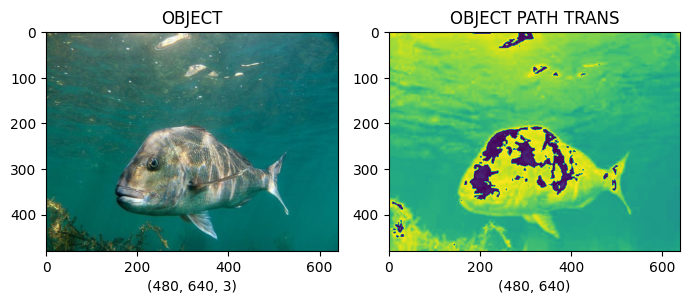

In [ ]:
EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][640]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][640]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_OBJECT)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
OBJECT_PATH_TRANS = COPY_OBJECT[:,:,0] - Green_I

figure,axis = plt.subplots(1,2,figsize=(7,7))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# highlight areas where the green channel has been modified or transformed. This type of analysis can be useful for understanding the impact of specific color channels on the overall appearance of the object
axis[1].set_xlabel(OBJECT_PATH_TRANS.shape)
axis[1].set_title("OBJECT PATH TRANS")
axis[1].imshow(OBJECT_PATH_TRANS)


plt.tight_layout()
plt.show()

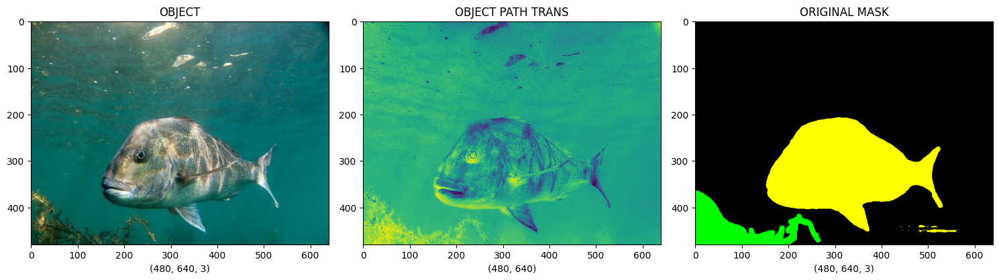

In [ ]:
EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][640]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][640]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_OBJECT)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
OBJECT_PATH_TRANS = COPY_OBJECT[:,:,0] - (Red_I + Blue_I)

figure,axis = plt.subplots(1,3,figsize=(15,15))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# represents the difference in pixel values between the blue channel of the copied object and the combined intensity of the red and blue channels in the original object.
# This operation may be used to highlight specific characteristics or variations in the blue channel that are not accounted for in the sum of the red and blue channels.
axis[1].set_xlabel(OBJECT_PATH_TRANS.shape)
axis[1].set_title("OBJECT PATH TRANS")
axis[1].imshow(OBJECT_PATH_TRANS)

axis[2].set_xlabel(EXAMPLE_MASK.shape)
axis[2].set_title("ORIGINAL MASK")
axis[2].imshow(EXAMPLE_MASK)

plt.tight_layout()
plt.show()

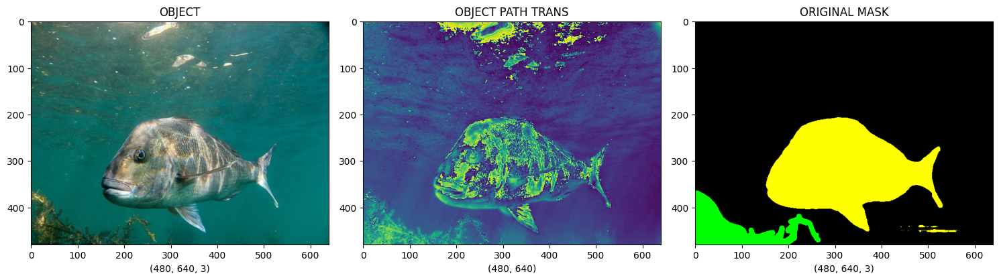

In [ ]:
EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][640]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][640]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_OBJECT)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
OBJECT_PATH_TRANS = COPY_OBJECT[:,:,0] - (Red_I + Green_I + Blue_I)

figure,axis = plt.subplots(1,3,figsize=(15,15))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# highlight specific characteristics or variations in the blue channel that are not accounted for in the total color intensity of the original object.
axis[1].set_xlabel(OBJECT_PATH_TRANS.shape)
axis[1].set_title("OBJECT PATH TRANS")
axis[1].imshow(OBJECT_PATH_TRANS)

axis[2].set_xlabel(EXAMPLE_MASK.shape)
axis[2].set_title("ORIGINAL MASK")
axis[2].imshow(EXAMPLE_MASK)

plt.tight_layout()
plt.show()

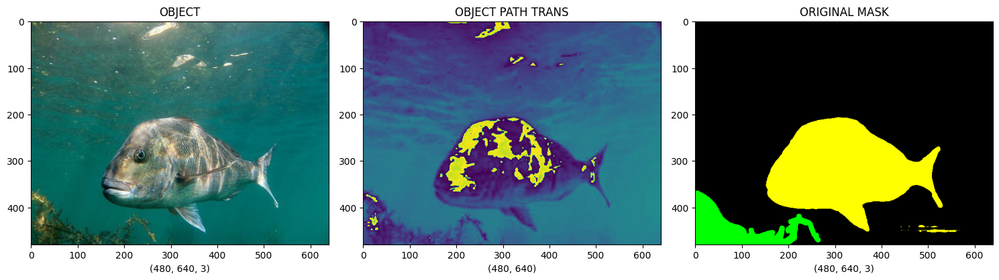

In [ ]:
EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][640]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][640]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_OBJECT)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
OBJECT_PATH_TRANS = COPY_OBJECT[:,:,1] - Red_I

figure,axis = plt.subplots(1,3,figsize=(15,15))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# represents the difference in pixel values between the green channel of the copied object and the red channel of the original object.
axis[1].set_xlabel(OBJECT_PATH_TRANS.shape)
axis[1].set_title("OBJECT PATH TRANS")
axis[1].imshow(OBJECT_PATH_TRANS)

axis[2].set_xlabel(EXAMPLE_MASK.shape)
axis[2].set_title("ORIGINAL MASK")
axis[2].imshow(EXAMPLE_MASK)

plt.tight_layout()
plt.show()

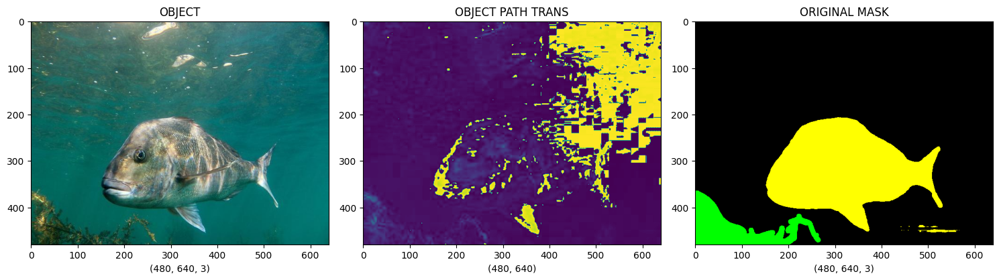

In [ ]:
EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][640]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][640]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_OBJECT)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
OBJECT_PATH_TRANS = COPY_OBJECT[:,:,1] - Blue_I

figure,axis = plt.subplots(1,3,figsize=(15,15))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# represents the difference in pixel values between the green channel of the copied object and the blue channel of the original object.
axis[1].set_xlabel(OBJECT_PATH_TRANS.shape)
axis[1].set_title("OBJECT PATH TRANS")
axis[1].imshow(OBJECT_PATH_TRANS)

axis[2].set_xlabel(EXAMPLE_MASK.shape)
axis[2].set_title("ORIGINAL MASK")
axis[2].imshow(EXAMPLE_MASK)

plt.tight_layout()
plt.show()

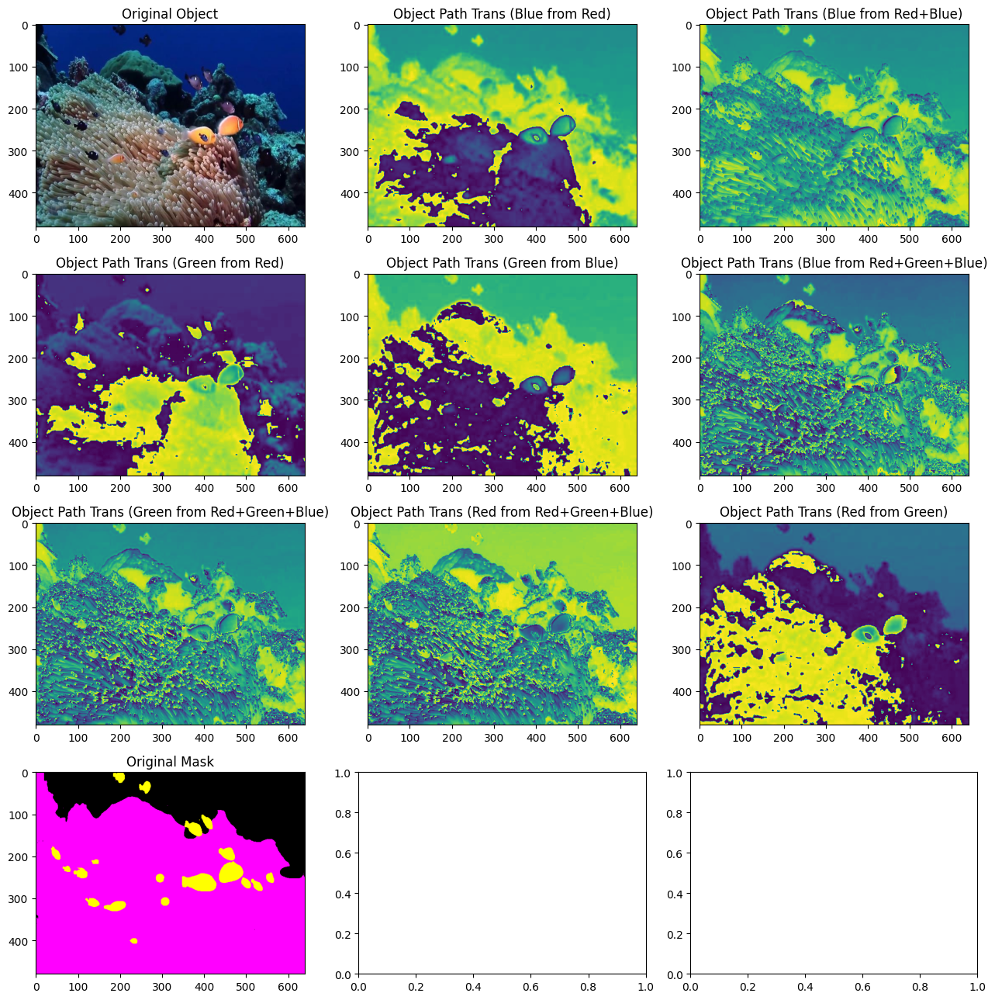

In [ ]:
# All the variations clubed in one plot


index_for_transformations = 911

EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index_for_transformations]), cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index_for_transformations]), cv2.COLOR_BGR2RGB)

# Splitting RGB channels of the example object
Red_I, Green_I, Blue_I = cv2.split(EXAMPLE_OBJECT)

# Creating a copy of the example object
COPY_OBJECT = EXAMPLE_OBJECT.copy()

# Create a subplot grid
fig, axes = plt.subplots(4, 3, figsize=(13, 13))

# Original Object
axes[0, 0].imshow(EXAMPLE_OBJECT)
axes[0, 0].set_title("Original Object")

# Object Path Transformation 1 (Blue from Red)
OBJECT_PATH_TRANS_1 = COPY_OBJECT[:, :, 0] - Blue_I
axes[0, 1].imshow(OBJECT_PATH_TRANS_1)
axes[0, 1].set_title("Object Path Trans (Blue from Red)")

# Object Path Transformation 2 (Blue from Red+Blue)
OBJECT_PATH_TRANS_2 = COPY_OBJECT[:, :, 0] - (Red_I + Blue_I)
axes[0, 2].imshow(OBJECT_PATH_TRANS_2)
axes[0, 2].set_title("Object Path Trans (Blue from Red+Blue)")

# Object Path Transformation 3 (Green from Red)
OBJECT_PATH_TRANS_3 = COPY_OBJECT[:, :, 1] - Red_I
axes[1, 0].imshow(OBJECT_PATH_TRANS_3)
axes[1, 0].set_title("Object Path Trans (Green from Red)")

# Object Path Transformation 4 (Green from Blue)
OBJECT_PATH_TRANS_4 = COPY_OBJECT[:, :, 1] - Blue_I
axes[1, 1].imshow(OBJECT_PATH_TRANS_4)
axes[1, 1].set_title("Object Path Trans (Green from Blue)")

# Object Path Transformation 5 (Blue from Red+Green+Blue)
OBJECT_PATH_TRANS_5 = COPY_OBJECT[:, :, 0] - (Red_I + Green_I + Blue_I)
axes[1, 2].imshow(OBJECT_PATH_TRANS_5)
axes[1, 2].set_title("Object Path Trans (Blue from Red+Green+Blue)")

# Object Path Transformation 6 (Green from Red+Green+Blue)
OBJECT_PATH_TRANS_6 = COPY_OBJECT[:, :, 1] - (Red_I + Green_I + Blue_I)
axes[2, 0].imshow(OBJECT_PATH_TRANS_6)
axes[2, 0].set_title("Object Path Trans (Green from Red+Green+Blue)")

# Object Path Transformation 7 (Red from Red+Green+Blue)
OBJECT_PATH_TRANS_7 = COPY_OBJECT[:, :, 2] - (Red_I + Green_I + Blue_I)
axes[2, 1].imshow(OBJECT_PATH_TRANS_7)
axes[2, 1].set_title("Object Path Trans (Red from Red+Green+Blue)")

# Object Path Transformation 8 (Red from Green)
OBJECT_PATH_TRANS_8 = COPY_OBJECT[:, :, 2] - Green_I
axes[2, 2].imshow(OBJECT_PATH_TRANS_8)
axes[2, 2].set_title("Object Path Trans (Red from Green)")

# Original Mask
axes[3, 0].imshow(EXAMPLE_MASK)
axes[3, 0].set_title("Original Mask")

plt.tight_layout()
plt.show()


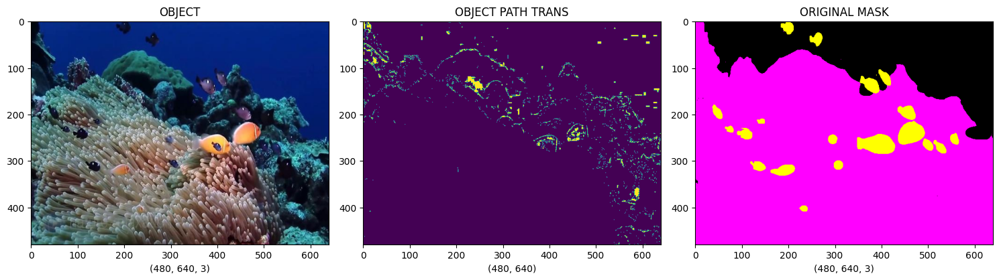

In [ ]:
# sub layer mask

EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][911]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][911]),cv2.COLOR_BGR2RGB)

Red_I,Green_I,Blue_I = cv2.split(EXAMPLE_MASK)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
OBJECT_PATH_TRANS = COPY_OBJECT[:,:,0] == Green_I

figure,axis = plt.subplots(1,3,figsize=(15,15))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# highlights the pixels where the blue channel in the copied object matches the green channel in the original object
axis[1].set_xlabel(OBJECT_PATH_TRANS.shape)
axis[1].set_title("OBJECT PATH TRANS")
axis[1].imshow(OBJECT_PATH_TRANS)

axis[2].set_xlabel(EXAMPLE_MASK.shape)
axis[2].set_title("ORIGINAL MASK")
axis[2].imshow(EXAMPLE_MASK)

plt.tight_layout()
plt.show()

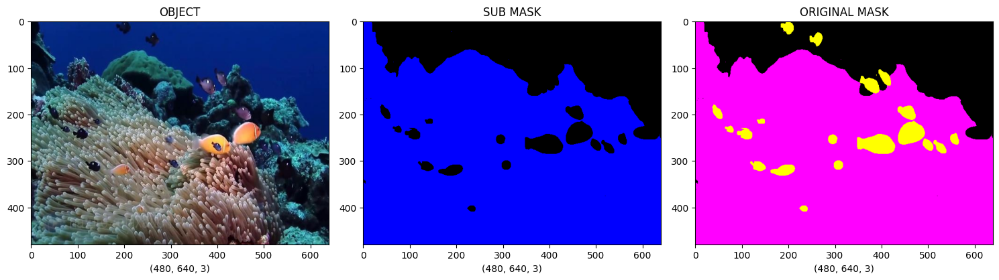

In [ ]:
# sub color space

EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][911]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][911]),cv2.COLOR_BGR2RGB)

COPY_MASK = EXAMPLE_MASK.copy()
COPY_MASK[:, :, 0] = 0
COPY_MASK[:, :, 1] = 0

figure,axis = plt.subplots(1,3,figsize=(15,15))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# emphasize the information in the red channel of the mask. By setting the blue and green channels to 0 in the copied mask, we isolate and display only the red channel, which may be useful for highlighting specific features or characteristics present in the original mask's red channel.
axis[1].set_xlabel(COPY_MASK.shape)
axis[1].set_title("SUB MASK")
axis[1].imshow(COPY_MASK)

axis[2].set_xlabel(EXAMPLE_MASK.shape)
axis[2].set_title("ORIGINAL MASK")
axis[2].imshow(EXAMPLE_MASK)

plt.tight_layout()
plt.show()

In [ ]:
# target on rgb codes

RED_COLOR_CODE = [255,0,0]
GREEN_COLOR_CODE = [0,255,0]
BLUE_COLOR_CODE = [0,0,255]

YELLOW_COLOR_CODE = [255,255,0]
BLACK_COLOR_CODE = [0,0,0]
WHITE_COLOR_CODE = [255,255,255]

PINK_COLOR_CODE = [255,192,203]
SKY_BLUE_COLOR_CODE = [135,206,235]

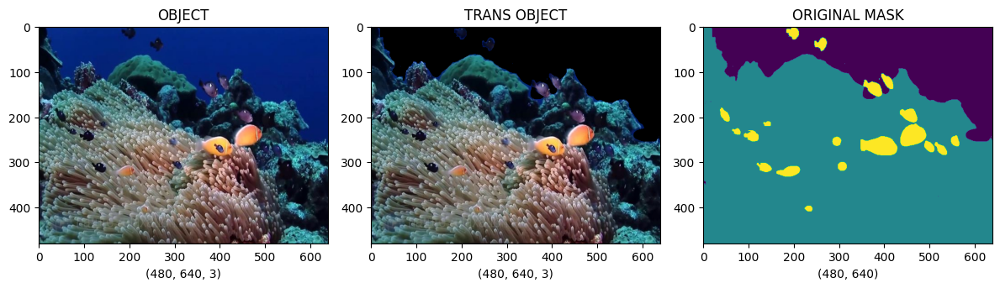

In [ ]:
EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][911]),cv2.COLOR_BGR2RGB)
EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][911]),cv2.COLOR_BGR2GRAY)

COPY_OBJECT = EXAMPLE_OBJECT.copy()
COPY_OBJECT[EXAMPLE_MASK == 0] = BLACK_COLOR_CODE

figure,axis = plt.subplots(1,3,figsize=(12,12))

axis[0].set_xlabel(EXAMPLE_OBJECT.shape)
axis[0].set_title("OBJECT")
axis[0].imshow(EXAMPLE_OBJECT)

# highlights areas in the object image where the mask has a value of 0 by setting those areas to black
axis[1].set_xlabel(COPY_OBJECT.shape)
axis[1].set_title("TRANS OBJECT")
axis[1].imshow(COPY_OBJECT)

axis[2].set_xlabel(EXAMPLE_MASK.shape)
axis[2].set_title("ORIGINAL MASK")
axis[2].imshow(EXAMPLE_MASK)

plt.tight_layout()
plt.show()

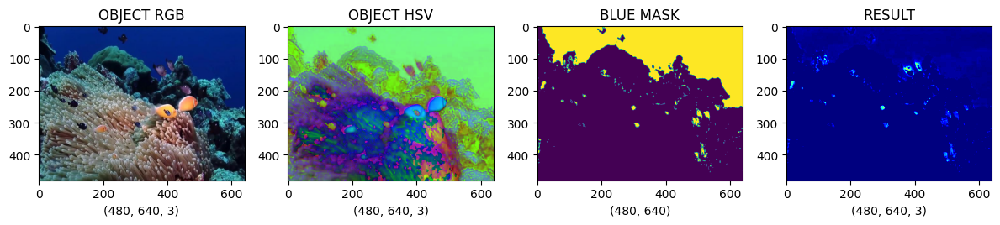

In [ ]:
# process of isolating blue regions in an object image using HSV color space

UPPER_BLUE = np.array([130,255,255])
LOWER_BLUE = np.array([110,50,50])

EXAMPLE_OBJECT_RGB = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][911]),cv2.COLOR_BGR2RGB)
EXAMPLE_OBJECT_HSV = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][911]),cv2.COLOR_BGR2HSV)
BLUE_MASK = cv2.inRange(EXAMPLE_OBJECT_HSV, LOWER_BLUE, UPPER_BLUE)
RESULT_IMAGE_EXAMPLE = cv2.bitwise_and(EXAMPLE_OBJECT_RGB, EXAMPLE_OBJECT_RGB, mask=BLUE_MASK)

figure,axis = plt.subplots(1,4,figsize=(12,12))

axis[0].set_xlabel(EXAMPLE_OBJECT_RGB.shape)
axis[0].set_title("OBJECT RGB")
axis[0].imshow(EXAMPLE_OBJECT_RGB)

# object image converted to the HSV color space
axis[1].set_xlabel(EXAMPLE_OBJECT_HSV.shape)
axis[1].set_title("OBJECT HSV")
axis[1].imshow(EXAMPLE_OBJECT_HSV)

# binary blue mask created based on the HSV range
axis[2].set_xlabel(BLUE_MASK.shape)
axis[2].set_title("BLUE MASK")
axis[2].imshow(BLUE_MASK)

# only the blue regions are retained, and the rest are set to 0 (black)
axis[3].set_xlabel(RESULT_IMAGE_EXAMPLE.shape)
axis[3].set_title("RESULT")
axis[3].imshow(RESULT_IMAGE_EXAMPLE[:,:,0],cmap="jet")

plt.tight_layout()
plt.show()

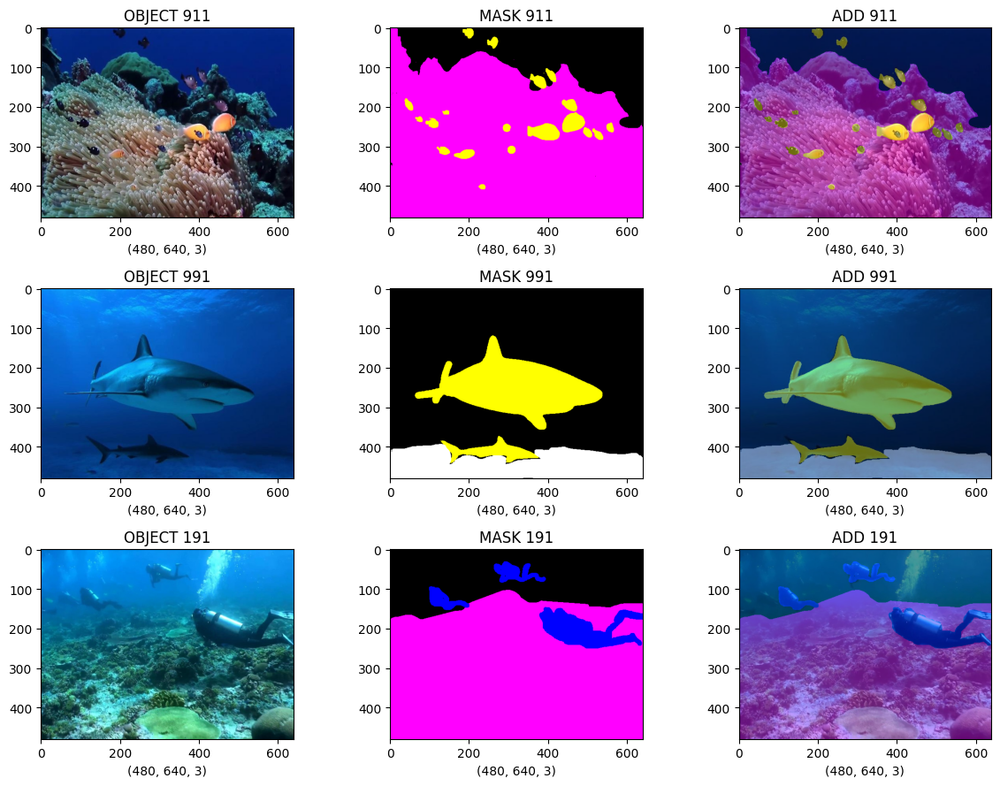

In [ ]:
# Object and mask

selected_indexes = [911, 991, 191]
figure, axes = plt.subplots(len(selected_indexes), 3, figsize=(12, 3 * len(selected_indexes)))

for i, index in enumerate(selected_indexes):
    # Read example object and mask
    EXAMPLE_OBJECT = cv2.cvtColor(cv2.imread(MAIN_DATA["OBJECTS"][index]), cv2.COLOR_BGR2RGB)
    EXAMPLE_MASK = cv2.cvtColor(cv2.imread(MAIN_DATA["MASK"][index]), cv2.COLOR_BGR2RGB)

    # Blend object and mask
    # blending operation is controlled by the weights assigned to the object and mask images. In this case, the object contributes 60% (weight = 0.6), the mask contributes 40% (weight = 0.4), and a gamma factor of 0.5 is applied
    ADD_IMAGE = cv2.addWeighted(EXAMPLE_OBJECT, 0.6, EXAMPLE_MASK, 0.4, 0.5)

    # Plotting the images
    axes[i, 0].set_xlabel(EXAMPLE_OBJECT.shape)
    axes[i, 0].set_title(f"OBJECT {index}")
    axes[i, 0].imshow(EXAMPLE_OBJECT)

    axes[i, 1].set_xlabel(EXAMPLE_MASK.shape)
    axes[i, 1].set_title(f"MASK {index}")
    axes[i, 1].imshow(EXAMPLE_MASK)

    axes[i, 2].set_xlabel(ADD_IMAGE.shape)
    axes[i, 2].set_title(f"ADD {index}")
    axes[i, 2].imshow(ADD_IMAGE)

plt.tight_layout()
plt.show()


In [14]:
# Data transformation

MASK_MAIN_TRANSFORMATION = []
OBJECT_MAIN_TRANSFORMATION = []
ADD_MAIN_TRANSFORMATION = []

In [15]:
for x_image,x_mask in zip(MAIN_DATA.OBJECTS,MAIN_DATA.MASK):

    IMAGE_X = cv2.cvtColor(cv2.imread(x_image),cv2.COLOR_BGR2RGB)
    MASK_X = cv2.cvtColor(cv2.imread(x_mask),cv2.COLOR_BGR2RGB)

    RESIZED_X_IMAGE = cv2.resize(IMAGE_X,(256,256))
    RESIZED_X_MASK = cv2.resize(MASK_X,(256,256))

    ADD_X = cv2.addWeighted(RESIZED_X_IMAGE,0.6,RESIZED_X_MASK,0.6,0.5)

    RESIZED_X_ADD = cv2.resize(ADD_X,(256,256))

    MASK_MAIN_TRANSFORMATION.append(RESIZED_X_MASK)
    OBJECT_MAIN_TRANSFORMATION.append(RESIZED_X_IMAGE)
    ADD_MAIN_TRANSFORMATION.append(RESIZED_X_ADD)

In [16]:
print("IMAGE SHAPE: ",np.shape(np.array(OBJECT_MAIN_TRANSFORMATION)))
print("MASK SHAPE: ",np.shape(np.array(MASK_MAIN_TRANSFORMATION)))
print("ADD(blended image) SHAPE: ",np.shape(np.array(ADD_MAIN_TRANSFORMATION)))

IMAGE SHAPE:  (1525, 256, 256, 3)
MASK SHAPE:  (1525, 256, 256, 3)
ADD(blended image) SHAPE:  (1525, 256, 256, 3)


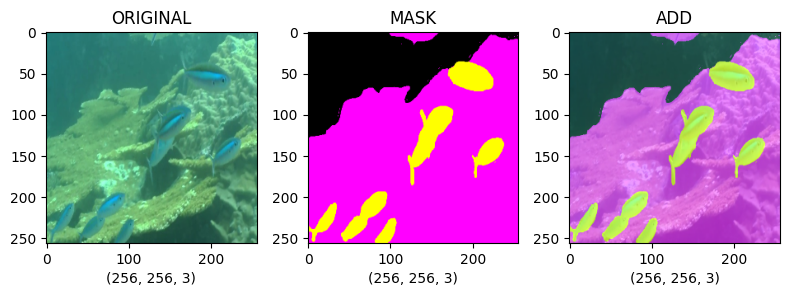

In [17]:
figure,axis = plt.subplots(1,3,figsize=(8,8))

axis[0].imshow(OBJECT_MAIN_TRANSFORMATION[919],cmap="jet")
axis[0].set_xlabel(OBJECT_MAIN_TRANSFORMATION[919].shape)
axis[0].set_title("ORIGINAL")

axis[1].imshow(MASK_MAIN_TRANSFORMATION[919])
axis[1].set_xlabel(MASK_MAIN_TRANSFORMATION[919].shape)
axis[1].set_title("MASK")

axis[2].imshow(ADD_MAIN_TRANSFORMATION[919])
axis[2].set_xlabel(ADD_MAIN_TRANSFORMATION[919].shape)
axis[2].set_title("ADD")

plt.tight_layout()
plt.show()

In [18]:
Transformation_Image = np.array(OBJECT_MAIN_TRANSFORMATION,dtype="float32")
Transformation_Mask = np.array(MASK_MAIN_TRANSFORMATION,dtype="float32")
Transformation_Add = np.array(ADD_MAIN_TRANSFORMATION,dtype="float32")

Transformation_Image = Transformation_Image / 255.
Transformation_Mask = Transformation_Mask / 255.
Transformation_Add = Transformation_Add / 255.

print("TRAIN: ",Transformation_Image.shape)
print("TRANSFORMATION MASK: ",Transformation_Mask.shape)
print("TRANSFORMATION ADD: ",Transformation_Add.shape)

TRAIN:  (1525, 256, 256, 3)
TRANSFORMATION MASK:  (1525, 256, 256, 3)
TRANSFORMATION ADD:  (1525, 256, 256, 3)


## Model 1

In [ ]:
# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(
    Transformation_Image, Transformation_Mask, test_size=0.2, random_state=42
)

In [ ]:
# Auto Encoder Process

In [ ]:
# Define the autoencoder model
def build_autoencoder():
    input_img = Input(shape=(256, 256, 3))

    # Encoder
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    # Decoder
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer='adam', loss='mean_squared_error')

    return autoencoder

# Build the autoencoder
autoencoder = build_autoencoder()

# Train the autoencoder
history = autoencoder.fit(
    X_train, y_train,
    epochs=5,
    batch_size=32,
    shuffle=True,
    validation_data=(X_val, y_val)
)

train_loss = history.history['loss']
val_loss = history.history['val_loss']

Epoch 1/4
39/39 [==============================] - 20s 242ms/step - loss: 0.2118 - val_loss: 0.1859
Epoch 2/4
39/39 [==============================] - 5s 135ms/step - loss: 0.1895 - val_loss: 0.1846
Epoch 3/4
39/39 [==============================] - 5s 134ms/step - loss: 0.1913 - val_loss: 0.1747
Epoch 4/4
39/39 [==============================] - 5s 138ms/step - loss: 0.1823 - val_loss: 0.1739


In [ ]:
Prediction_Seen = autoencoder.predict(Transformation_Image[:10])

1/1 [==============================] - 1s 867ms/step


1/1 [==============================] - 0s 435ms/step


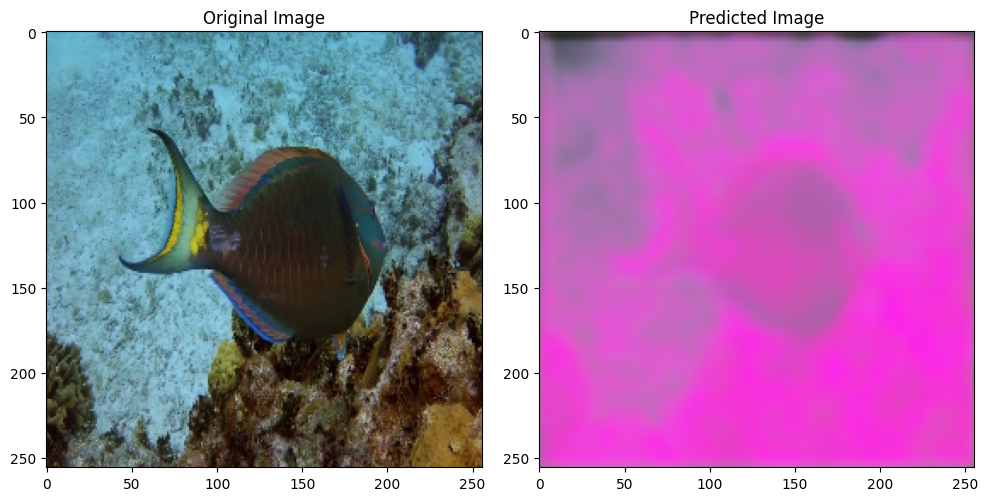

1/1 [==============================] - 0s 28ms/step


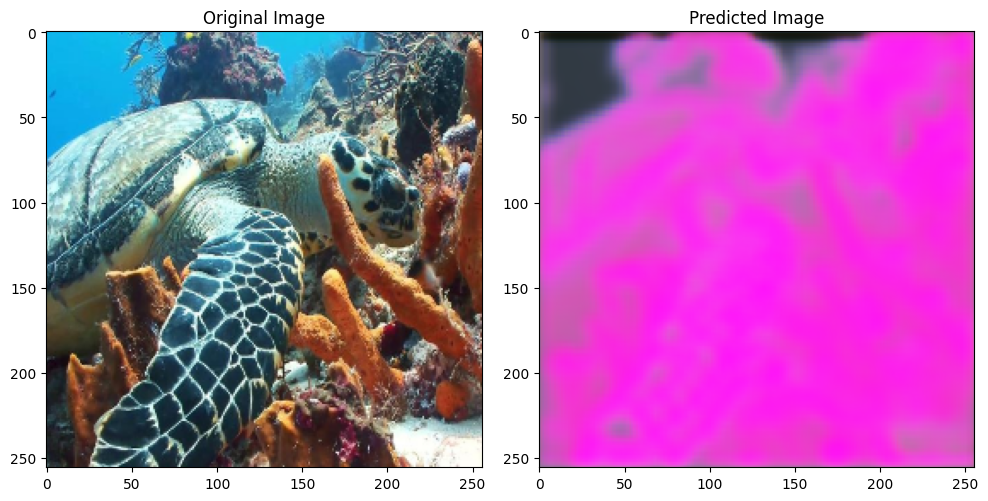

1/1 [==============================] - 0s 35ms/step


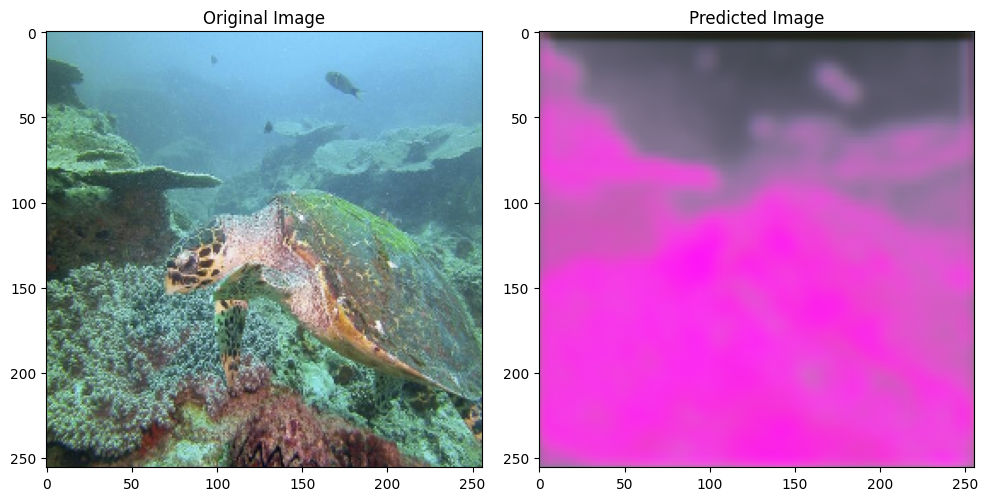

1/1 [==============================] - 0s 34ms/step


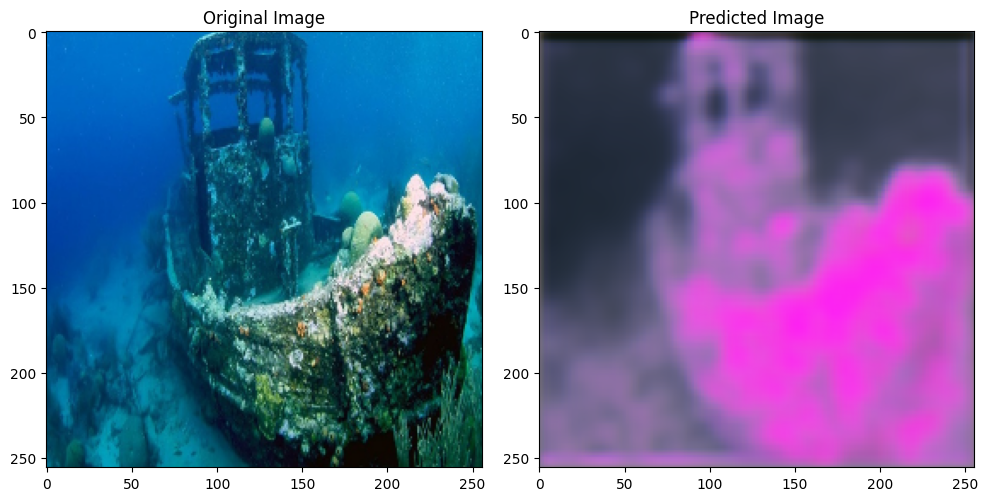

1/1 [==============================] - 0s 38ms/step


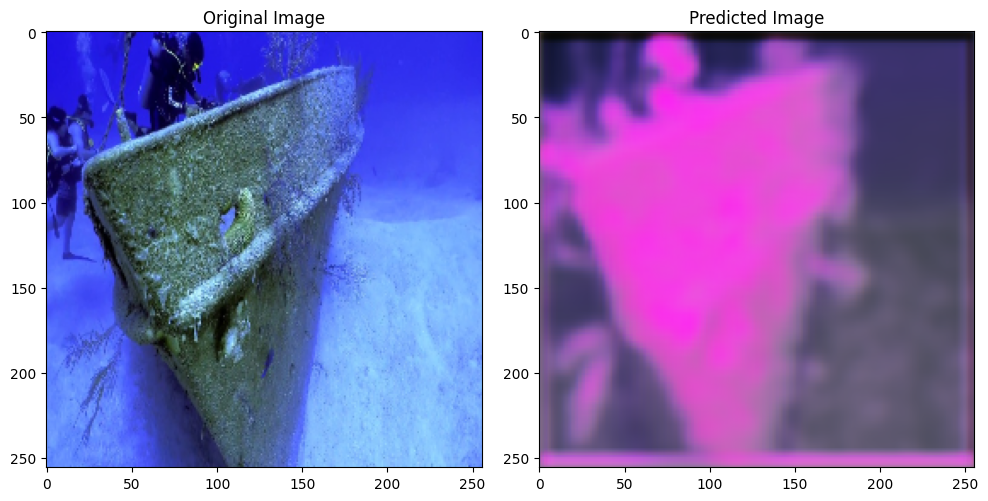

In [ ]:
random_indices = random.sample(range(len(Transformation_Image)), 5)

for idx in random_indices:
    # Original Image
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(Transformation_Image[idx])
    plt.title("Original Image")

    # Predicted Image
    plt.subplot(1, 2, 2)
    # Reshape the prediction to match the original image shape
    predicted_image = autoencoder.predict(np.expand_dims(Transformation_Image[idx], axis=0))[0]
    plt.imshow(predicted_image)
    plt.title("Predicted Image")

    plt.tight_layout()
    plt.show()

## Model 2


In [ ]:
# Split the data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(
    Transformation_Image, Transformation_Add, test_size=0.2, random_state=42
)

In [ ]:
# Define the autoencoder model
def build_autoencoder():
    input_img = Input(shape=(256, 256, 3))

    # Encoder
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_img)
    x = MaxPooling2D((2, 2), padding='same')(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    encoded = MaxPooling2D((2, 2), padding='same')(x)

    # Decoder
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(encoded)
    x = UpSampling2D((2, 2))(x)
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = UpSampling2D((2, 2))(x)
    decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)

    autoencoder = Model(input_img, decoded)
    autoencoder.compile(optimizer='adam', loss='mean_squared_error')

    return autoencoder

# Build the autoencoder
autoencoder2 = build_autoencoder()

# Train the autoencoder
history = autoencoder2.fit(
    X_train, y_train,
    epochs=5,
    batch_size=32,
    shuffle=True,
    validation_data=(X_val, y_val)
)

train_loss = history.history['loss']
val_loss = history.history['val_loss']

Epoch 1/5
39/39 [==============================] - 22s 270ms/step - loss: 0.0812 - val_loss: 0.0682
Epoch 2/5
39/39 [==============================] - 5s 135ms/step - loss: 0.0705 - val_loss: 0.0644
Epoch 3/5
39/39 [==============================] - 6s 166ms/step - loss: 0.0682 - val_loss: 0.0635
Epoch 4/5
39/39 [==============================] - 6s 139ms/step - loss: 0.0661 - val_loss: 0.0622
Epoch 5/5
39/39 [==============================] - 5s 138ms/step - loss: 0.0660 - val_loss: 0.0647


1/1 [==============================] - 0s 350ms/step


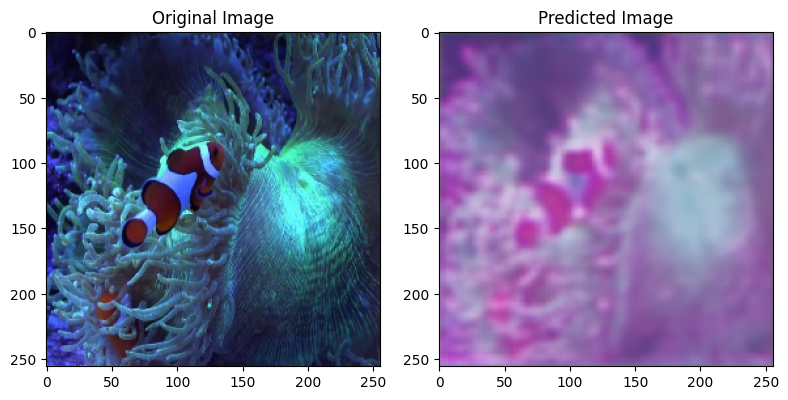

1/1 [==============================] - 0s 26ms/step


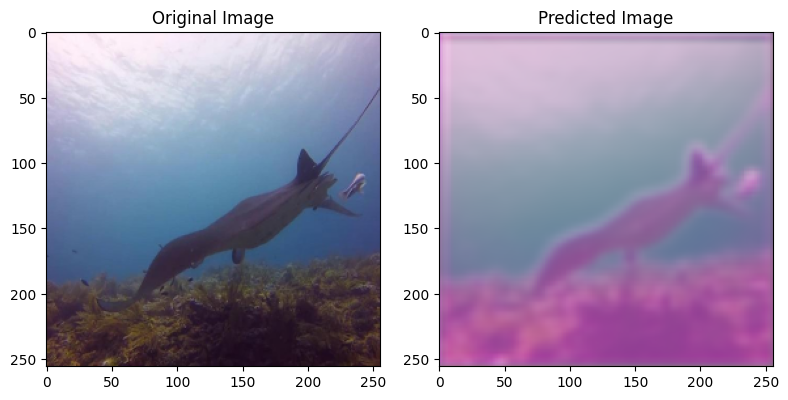

1/1 [==============================] - 0s 25ms/step


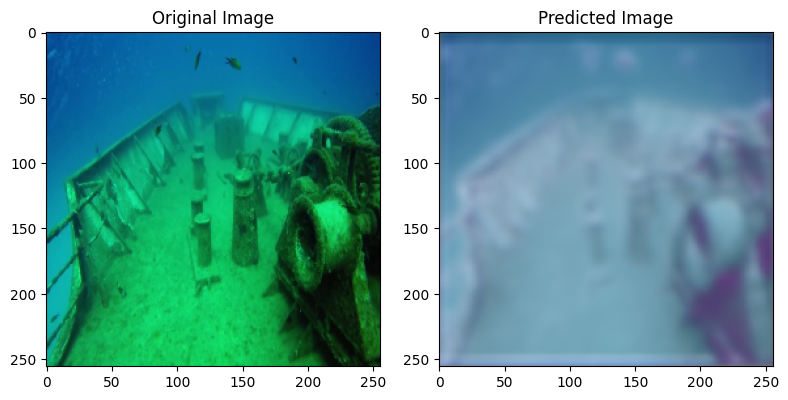

1/1 [==============================] - 0s 19ms/step


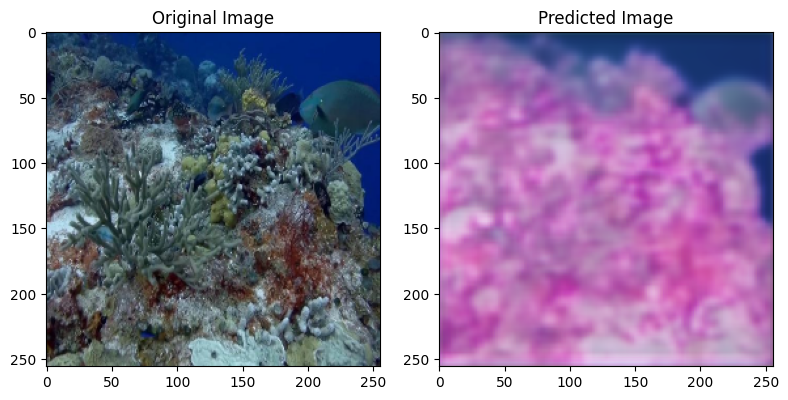

1/1 [==============================] - 0s 25ms/step


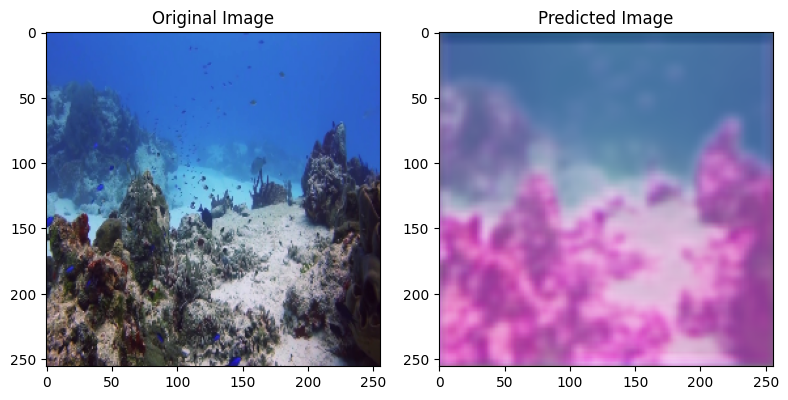

In [ ]:
Prediction_Seen = autoencoder2.predict(Transformation_Image[:10])
random_indices = random.sample(range(len(Transformation_Image)), 5)

for idx in random_indices:
    # Original Image
    plt.figure(figsize=(8, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(Transformation_Image[idx])
    plt.title("Original Image")

    # Predicted Image
    plt.subplot(1, 2, 2)
    # Reshape the prediction to match the original image shape
    predicted_image = autoencoder2.predict(np.expand_dims(Transformation_Image[idx], axis=0))[0]
    plt.imshow(predicted_image)
    plt.title("Predicted Image")

    plt.tight_layout()
    plt.show()

## Model 3

In [ ]:
compile_loss = "binary_crossentropy"
compile_optimizer = Adam(lr=0.00001)
output_class = 3

Checkpoint_Model = tf.keras.callbacks.ModelCheckpoint(monitor="val_accuracy",
                                                      save_best_only=True,
                                                      save_weights_only=True,
                                                      filepath="./modelcheck")

In [ ]:
E_AE = Sequential()
#
E_AE.add(Conv2D(32,(2,2),kernel_initializer = 'he_normal',use_bias = True, padding="same"))
E_AE.add(BatchNormalization())
E_AE.add(ReLU())
#
E_AE.add(Conv2D(64,(2,2),kernel_initializer = 'he_normal',use_bias = True, padding="same"))
E_AE.add(BatchNormalization())
E_AE.add(ReLU())
#
E_AE.add(Conv2D(128,(5,5),kernel_initializer = 'he_normal',use_bias = True, padding="same"))
E_AE.add(BatchNormalization())
E_AE.add(ReLU())




D_AE = Sequential()
#
D_AE.add(Conv2DTranspose(64,(2,2), padding="same"))
D_AE.add(ReLU())
#
D_AE.add(Conv2DTranspose(32,(5,5), padding="same"))
D_AE.add(ReLU())
#
D_AE.add(Conv2DTranspose(output_class,(5,5), padding="same"))
D_AE.add(ReLU())


Auto_Encoder3 = Sequential([E_AE,D_AE])
Auto_Encoder3.compile(loss=compile_loss,optimizer=compile_optimizer,metrics=["mse"])

In [ ]:
Model_AutoEncoder3 = Auto_Encoder3.fit(Transformation_Image,Transformation_Add,epochs=5,callbacks=[Checkpoint_Model])


Epoch 1/5
48/48 [==============================] - ETA: 0s - loss: 1.2780 - mse: 0.2550

48/48 [==============================] - 98s 1s/step - loss: 1.2780 - mse: 0.2550
Epoch 2/5
48/48 [==============================] - ETA: 0s - loss: 0.6407 - mse: 0.0802

48/48 [==============================] - 35s 721ms/step - loss: 0.6407 - mse: 0.0802
Epoch 3/5
48/48 [==============================] - ETA: 0s - loss: 0.6245 - mse: 0.0737

48/48 [==============================] - 35s 726ms/step - loss: 0.6245 - mse: 0.0737
Epoch 4/5
48/48 [==============================] - ETA: 0s - loss: 0.6220 - mse: 0.0727

48/48 [==============================] - 35s 727ms/step - loss: 0.6220 - mse: 0.0727
Epoch 5/5
48/48 [==============================] - ETA: 0s - loss: 0.6094 - mse: 0.0675

48/48 [==============================] - 35s 725ms/step - loss: 0.6094 - mse: 0.0675


1/1 [==============================] - 1s 804ms/step


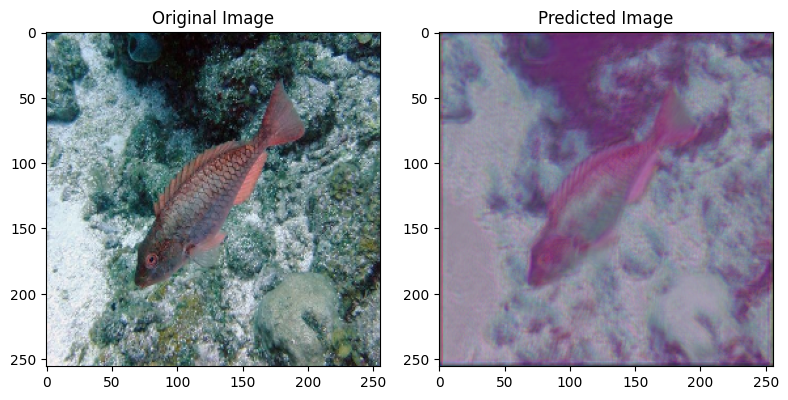

1/1 [==============================] - 0s 73ms/step


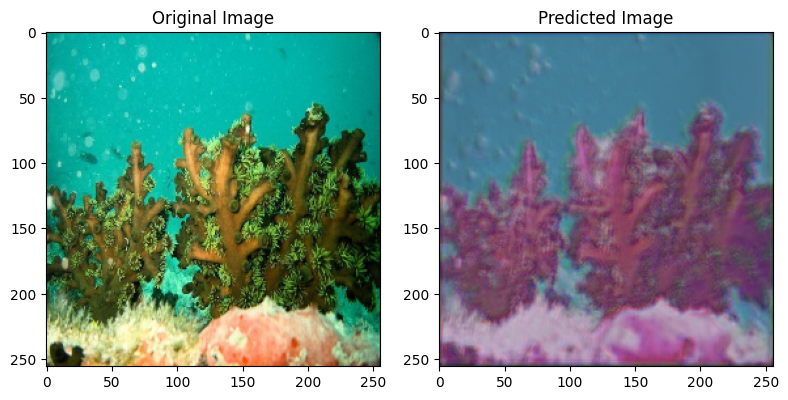

1/1 [==============================] - 0s 57ms/step


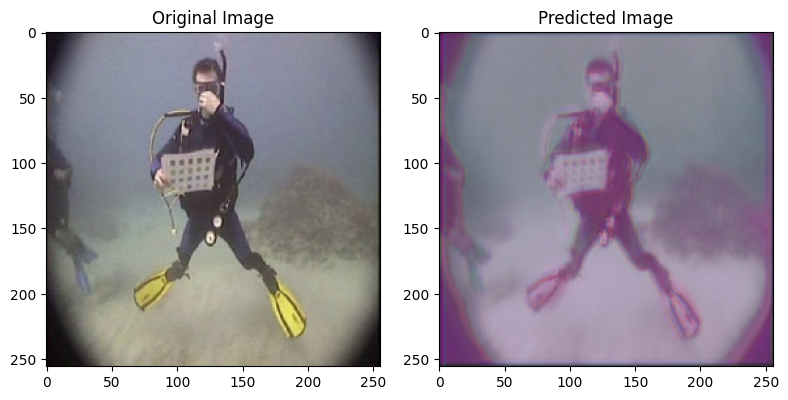

1/1 [==============================] - 0s 31ms/step


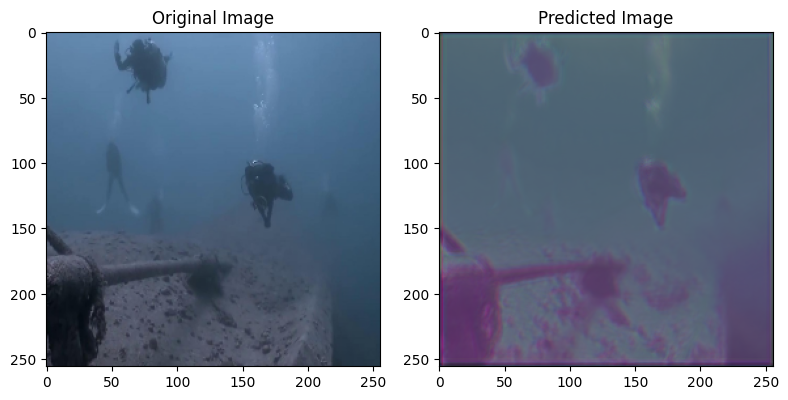

1/1 [==============================] - 0s 37ms/step


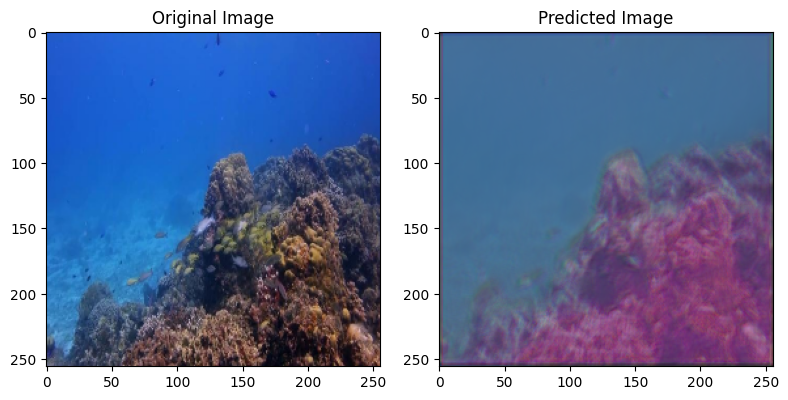

In [ ]:
Prediction_Seen = Auto_Encoder3.predict(Transformation_Image[:10])
random_indices = random.sample(range(len(Transformation_Image)), 5)

for idx in random_indices:
    # Original Image
    plt.figure(figsize=(8, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(Transformation_Image[idx])
    plt.title("Original Image")

    # Predicted Image
    plt.subplot(1, 2, 2)
    # Reshape the prediction to match the original image shape
    predicted_image = Auto_Encoder3.predict(np.expand_dims(Transformation_Image[idx], axis=0))[0]
    plt.imshow(predicted_image)
    plt.title("Predicted Image")

    plt.tight_layout()
    plt.show()

1/1 [==============================] - 0s 36ms/step


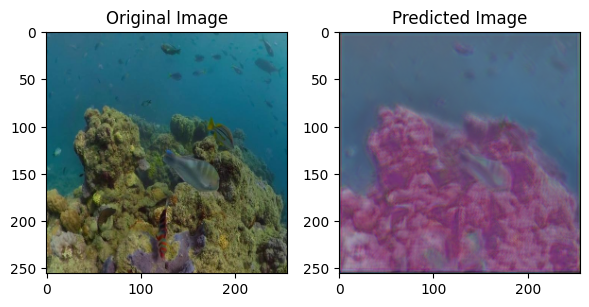

1/1 [==============================] - 0s 65ms/step


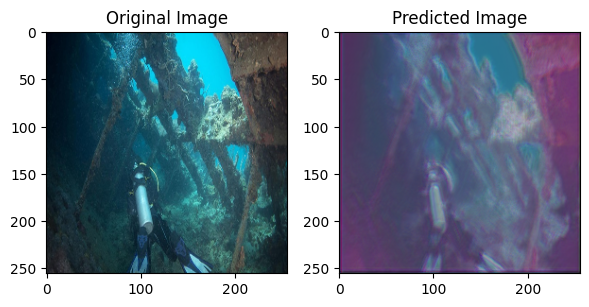

1/1 [==============================] - 0s 52ms/step


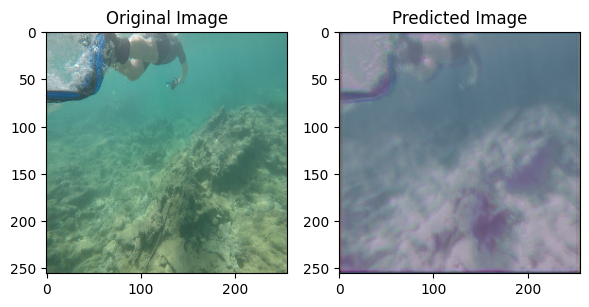

1/1 [==============================] - 0s 29ms/step


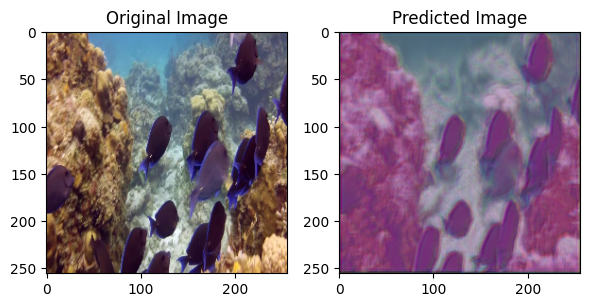

1/1 [==============================] - 0s 32ms/step


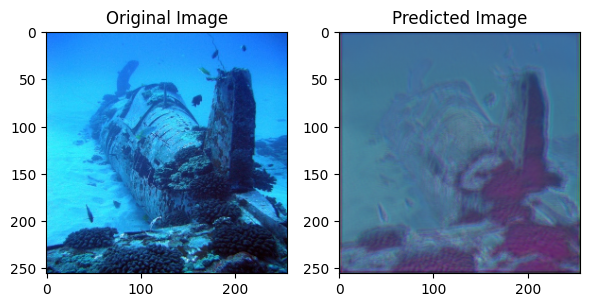

In [ ]:
random_indices = random.sample(range(len(Transformation_Image)), 5)

for idx in random_indices:
    # Original Image
    plt.figure(figsize=(6, 3))
    plt.subplot(1, 2, 1)
    plt.imshow(Transformation_Image[idx])
    plt.title("Original Image")

    # Predicted Image
    plt.subplot(1, 2, 2)
    # Reshape the prediction to match the original image shape
    predicted_image = Auto_Encoder3.predict(np.expand_dims(Transformation_Image[idx], axis=0))[0]
    predicted_image = np.clip(predicted_image, 0, 1)  # Clip values to [0, 1]
    plt.imshow(predicted_image)
    plt.title("Predicted Image")

    plt.tight_layout()
    plt.show()


## Model 4

In [19]:
compile_loss = "binary_crossentropy"
compile_optimizer = Adam(lr=0.000001)
output_class = 3

Checkpoint_Model = tf.keras.callbacks.ModelCheckpoint(monitor="val_accuracy",
                                                      save_best_only=True,
                                                      save_weights_only=True,
                                                      filepath="./modelcheck")

In [20]:
Encoder_B = Sequential()
Encoder_B.add(Conv2D(32,(2,2),kernel_initializer = 'he_normal',padding = "same",use_bias = True))
Encoder_B.add(BatchNormalization())
Encoder_B.add(ReLU())
#
Encoder_B.add(Conv2D(64,(2,2),kernel_initializer = 'he_normal',padding = "same",use_bias = True))
Encoder_B.add(BatchNormalization())
Encoder_B.add(ReLU())
#
Encoder_B.add(Conv2D(128,(2,2),kernel_initializer = 'he_normal',padding = "same",use_bias = True))
Encoder_B.add(BatchNormalization())
Encoder_B.add(ReLU())


Decoder_B = Sequential()
#
Decoder_B.add(Conv2DTranspose(64,(2,2),padding = "same",use_bias = True))
Decoder_B.add(BatchNormalization())
Decoder_B.add(ReLU())
#
Decoder_B.add(Conv2DTranspose(32,(2,2),padding = "same",use_bias = True))
Decoder_B.add(BatchNormalization())
Decoder_B.add(ReLU())
#
Decoder_B.add(Conv2DTranspose(output_class,(2,2),padding = "same",use_bias = True))
Decoder_B.add(BatchNormalization())
Decoder_B.add(ReLU())

Auto_Encoder4 = Sequential([Encoder_B,Decoder_B])
Auto_Encoder4.compile(loss=compile_loss,optimizer=compile_optimizer,metrics=["mse"])

In [21]:
Model_AutoEncoder = Auto_Encoder4.fit(Transformation_Image,Transformation_Mask,epochs=20,callbacks=[Checkpoint_Model])

Epoch 1/20
48/48 [==============================] - ETA: 0s - loss: 2.4049 - mse: 0.3524

48/48 [==============================] - 51s 705ms/step - loss: 2.4049 - mse: 0.3524
Epoch 2/20
48/48 [==============================] - ETA: 0s - loss: 1.1278 - mse: 0.2507

48/48 [==============================] - 31s 640ms/step - loss: 1.1278 - mse: 0.2507
Epoch 3/20
48/48 [==============================] - ETA: 0s - loss: 0.9824 - mse: 0.2471

48/48 [==============================] - 31s 640ms/step - loss: 0.9824 - mse: 0.2471
Epoch 4/20
48/48 [==============================] - ETA: 0s - loss: 0.9055 - mse: 0.2370

48/48 [==============================] - 31s 644ms/step - loss: 0.9055 - mse: 0.2370
Epoch 5/20
48/48 [==============================] - ETA: 0s - loss: 0.8246 - mse: 0.2286

48/48 [==============================] - 31s 650ms/step - loss: 0.8246 - mse: 0.2286
Epoch 6/20
48/48 [==============================] - ETA: 0s - loss: 0.8017 - mse: 0.2194

48/48 [==============================] - 31s 655ms/step - loss: 0.8017 - mse: 0.2194
Epoch 7/20
48/48 [==============================] - ETA: 0s - loss: 0.7672 - mse: 0.2101

48/48 [==============================] - 32s 657ms/step - loss: 0.7672 - mse: 0.2101
Epoch 8/20
48/48 [==============================] - ETA: 0s - loss: 0.7412 - mse: 0.2070

48/48 [==============================] - 32s 664ms/step - loss: 0.7412 - mse: 0.2070
Epoch 9/20
48/48 [==============================] - ETA: 0s - loss: 0.7242 - mse: 0.2040

48/48 [==============================] - 32s 664ms/step - loss: 0.7242 - mse: 0.2040
Epoch 10/20
48/48 [==============================] - ETA: 0s - loss: 0.7031 - mse: 0.2047

48/48 [==============================] - 32s 666ms/step - loss: 0.7031 - mse: 0.2047
Epoch 11/20
48/48 [==============================] - ETA: 0s - loss: 0.6699 - mse: 0.1969

48/48 [==============================] - 32s 666ms/step - loss: 0.6699 - mse: 0.1969
Epoch 12/20
48/48 [==============================] - ETA: 0s - loss: 0.6903 - mse: 0.1972

48/48 [==============================] - 32s 667ms/step - loss: 0.6903 - mse: 0.1972
Epoch 13/20
48/48 [==============================] - ETA: 0s - loss: 0.6644 - mse: 0.1941

48/48 [==============================] - 32s 670ms/step - loss: 0.6644 - mse: 0.1941
Epoch 14/20
48/48 [==============================] - ETA: 0s - loss: 0.6770 - mse: 0.1951

48/48 [==============================] - 32s 670ms/step - loss: 0.6770 - mse: 0.1951
Epoch 15/20
48/48 [==============================] - ETA: 0s - loss: 0.6487 - mse: 0.1908

48/48 [==============================] - 32s 668ms/step - loss: 0.6487 - mse: 0.1908
Epoch 16/20
48/48 [==============================] - ETA: 0s - loss: 0.6971 - mse: 0.1953

48/48 [==============================] - 32s 671ms/step - loss: 0.6971 - mse: 0.1953
Epoch 17/20
48/48 [==============================] - ETA: 0s - loss: 0.6384 - mse: 0.1914

48/48 [==============================] - 32s 671ms/step - loss: 0.6384 - mse: 0.1914
Epoch 18/20
48/48 [==============================] - ETA: 0s - loss: 0.6327 - mse: 0.1911

48/48 [==============================] - 32s 670ms/step - loss: 0.6327 - mse: 0.1911
Epoch 19/20
48/48 [==============================] - ETA: 0s - loss: 0.6350 - mse: 0.1917

48/48 [==============================] - 32s 671ms/step - loss: 0.6350 - mse: 0.1917
Epoch 20/20
48/48 [==============================] - ETA: 0s - loss: 0.6283 - mse: 0.1901

48/48 [==============================] - 32s 671ms/step - loss: 0.6283 - mse: 0.1901


1/1 [==============================] - 1s 828ms/step


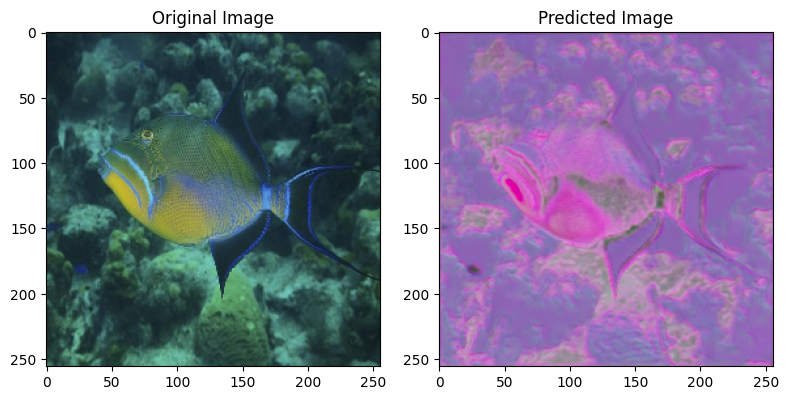

1/1 [==============================] - 0s 59ms/step


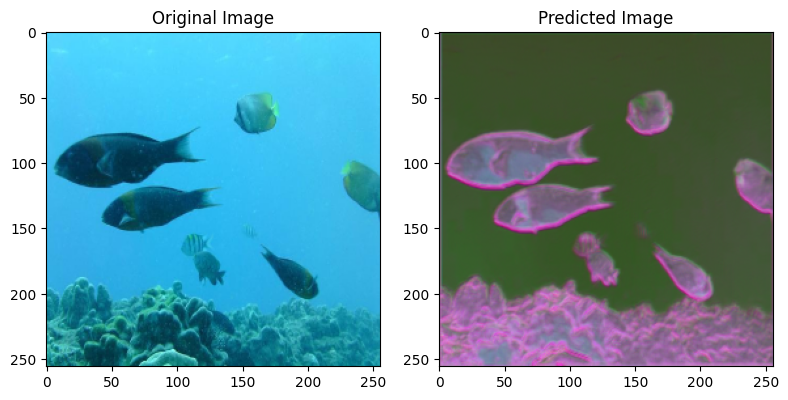

1/1 [==============================] - 0s 88ms/step


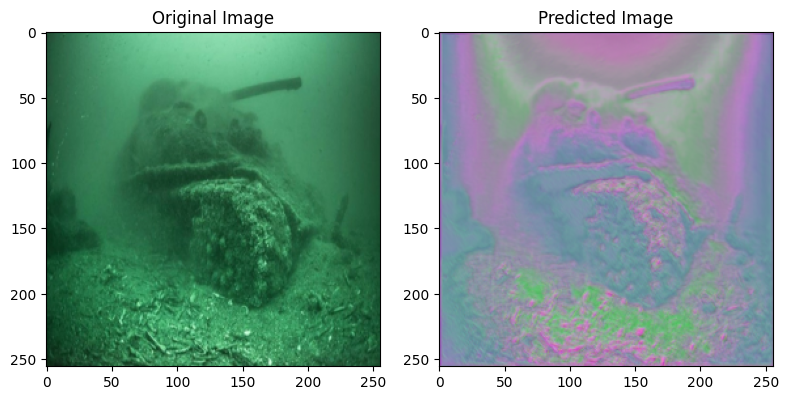

1/1 [==============================] - 0s 86ms/step


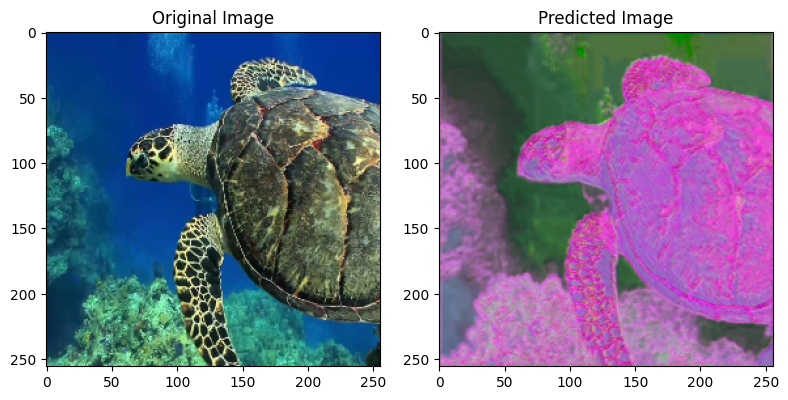

1/1 [==============================] - 0s 54ms/step


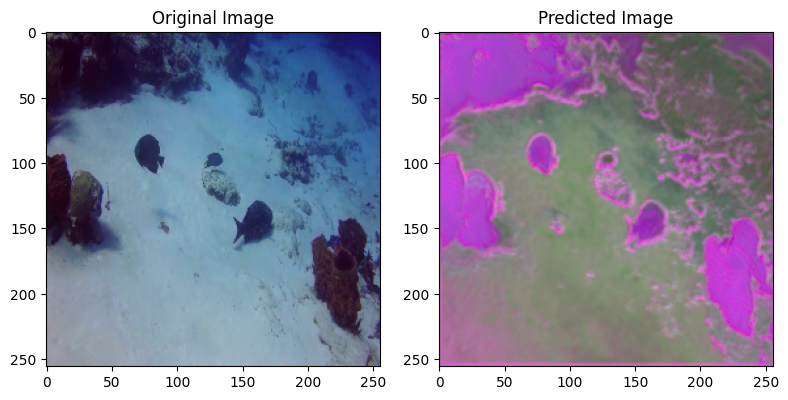

In [22]:
random_indices = random.sample(range(len(Transformation_Image)), 5)

for idx in random_indices:
    # Original Image
    plt.figure(figsize=(8, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(Transformation_Image[idx])
    plt.title("Original Image")

    # Predicted Image
    plt.subplot(1, 2, 2)
    # Reshape the prediction to match the original image shape
    predicted_image = Auto_Encoder4.predict(np.expand_dims(Transformation_Image[idx], axis=0))[0]
    plt.imshow(predicted_image)
    plt.title("Predicted Image")

    plt.tight_layout()
    plt.show()